**Import libraries and dependencies**

In [1]:
# REMOVE UNUSED LIBRARIES *************************************************
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as pl
from matplotlib import font_manager
import scanpy as sc
#import skimage #***********************
#import skmisc #***********************
import torch
import scvi
#import igraph #***********************
import scvelo as scv
import anndata
#import scipy.io #***********************
import re
#import tempfile #***********************
import seaborn as sns
import plotly.graph_objects as go
import plotly.express as px

#import omicverse as ov

#ov.utils.ov_plot_set()
#ov.utils.download_pathway_database()
#ov.utils.download_geneid_annotation_pair()


os.environ["CUDA_VISIBLE_DEVICES"] = "1"

/lustre/BIF/nobackup/perez070/miniconda3/envs/scRNA-seq_4/lib/python3.11/site-packages/docrep/decorators.py:43: SyntaxWarning: 'param_categorical_covariate_keys' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)
/lustre/BIF/nobackup/perez070/miniconda3/envs/scRNA-seq_4/lib/python3.11/site-packages/docrep/decorators.py:43: SyntaxWarning: 'param_continuous_covariate_keys' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)


In [2]:
# Matrix multiplication balancing precision and computational efficiency (options: medium-high-highest)
torch.set_float32_matmul_precision("high")

# Highest level of verbosity
sc.settings.verbosity = 3  

# Reproducibility
scvi.settings.seed = 1

# Figures
scv.set_figure_params(style="scvelo")

# Use Times New Roman as font
font_path = '/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/supp_data/misc/Times_New_Roman.ttf'
font_manager.fontManager.addfont(font_path)
prop = font_manager.FontProperties(fname=font_path)
pl.rcParams['font.family'] = 'sans-serif'
pl.rcParams['font.sans-serif'] = prop.get_name()

# Ignore warnings
import warnings
warnings.filterwarnings('ignore')

Seed set to 1


In [3]:
# Select samples
os.chdir('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/1-2_scKB_mapping')
samples = ['0h_1_scKB','0h_2_scKB','2h_1_scKB','2h_2_scKB','4h_1_scKB','4h_2_scKB','10h_1_scKB','10h_2_scKB']

# Retrieve sample name for Shahan et al. (2022) atlas
shahan_directory = "/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/supp_data/Shahan_samples"
shahan_ids = sorted([f.replace(".rds", "") for f in os.listdir(shahan_directory) if f.endswith(".rds")])
shahan_samples = [re.search(r'GSE152766_(.*?)_COPILOT', item).group(1) for item in shahan_ids]

# Needed to annotate the Shahan et al. (2022) atlas
analysis_dir = '/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/supp_data/misc/'
sample_labels = pd.read_csv(f'{analysis_dir}/samples.txt',sep='\t',header=None,index_col=0,names=['label','idx'])

In [5]:
# Read anndata objects and concatenate them
adatas = {}
for sample in samples:
    adata_path = f'/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/2-COPILOT/h5ad_files_total/{sample}_COPILOT.h5ad'
    adatas[sample] = anndata.read_h5ad(adata_path)

    print(adatas[sample])
    

for sample in shahan_samples:
    adata_path = f'/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/supp_data/Shahan_samples/h5ad_files/GSE152766_{sample}_COPILOT.h5ad'
    adatas[sample] = anndata.read_h5ad(adata_path)
    adatas[sample].obs.index += f'_{sample_labels.loc[sample].idx}'

    print(adatas[sample])


adata = list(adatas.values())[0].concatenate(list(adatas.values())[1:],batch_key='sample',batch_categories=adatas.keys(),index_unique=None, join="outer")
adata.obs_names_make_unique()
del(adatas)

AnnData object with n_obs × n_vars = 8349 × 27643
AnnData object with n_obs × n_vars = 6993 × 27795
AnnData object with n_obs × n_vars = 10371 × 26845
AnnData object with n_obs × n_vars = 11971 × 27086
AnnData object with n_obs × n_vars = 9269 × 26937
AnnData object with n_obs × n_vars = 8419 × 26885
AnnData object with n_obs × n_vars = 5899 × 26313
AnnData object with n_obs × n_vars = 7830 × 26393
AnnData object with n_obs × n_vars = 6433 × 25261
    obs: 'time.celltype.anno', 'celltype.anno', 'time.anno'
AnnData object with n_obs × n_vars = 9286 × 25901
    obs: 'time.celltype.anno', 'celltype.anno', 'time.anno'
AnnData object with n_obs × n_vars = 9177 × 25336
    obs: 'time.celltype.anno', 'celltype.anno', 'time.anno'


AnnData object with n_obs × n_vars = 10293 × 26291
    obs: 'time.celltype.anno', 'celltype.anno', 'time.anno'
AnnData object with n_obs × n_vars = 9759 × 25208
    obs: 'time.celltype.anno', 'celltype.anno', 'time.anno'
AnnData object with n_obs × n_vars = 10195 × 25207
    obs: 'time.celltype.anno', 'celltype.anno', 'time.anno'
AnnData object with n_obs × n_vars = 8775 × 25237
    obs: 'time.celltype.anno', 'celltype.anno', 'time.anno'
AnnData object with n_obs × n_vars = 5870 × 25748
    obs: 'time.celltype.anno', 'celltype.anno', 'time.anno'
AnnData object with n_obs × n_vars = 7284 × 26051
    obs: 'time.celltype.anno', 'celltype.anno', 'time.anno'
AnnData object with n_obs × n_vars = 6394 × 25197
    obs: 'time.celltype.anno', 'celltype.anno', 'time.anno'
AnnData object with n_obs × n_vars = 3808 × 25832
    obs: 'time.celltype.anno', 'celltype.anno', 'time.anno'
AnnData object with n_obs × n_vars = 4887 × 25785
    obs: 'time.celltype.anno', 'celltype.anno', 'time.anno'
AnnData 

In [5]:
# Remove cell type and developmental stage annotation to transfer it clean from scratch (and to add "Unknown" cells)
print(adata)
del adata.obs['celltype.anno']
del adata.obs['time.celltype.anno']
del adata.obs['time.anno']
print(adata)

AnnData object with n_obs × n_vars = 165200 × 30721
    obs: 'time.celltype.anno', 'celltype.anno', 'time.anno', 'sample'
AnnData object with n_obs × n_vars = 165200 × 30721
    obs: 'sample'


In [6]:
# Rename samples
adata.obs['batch'] = adata.obs['sample']
adata.obs['experiment'] = adata.obs['sample']
adata.obs['experiment'] = np.where(adata.obs['sample'].str.startswith('0h_'), '0h', adata.obs['experiment'])
adata.obs['experiment'] = np.where(adata.obs['sample'].str.startswith('2h_'), '2h', adata.obs['experiment'])
adata.obs['experiment'] = np.where(adata.obs['sample'].str.startswith('4h_'), '4h', adata.obs['experiment'])
adata.obs['experiment'] = np.where(adata.obs['sample'].str.startswith('10h_'), '10h', adata.obs['experiment'])
adata.obs['experiment'] = adata.obs['experiment'].astype('category')

In [7]:
# Put together the samples from Shahan et al. (2022)
adata.obs['experiment'] = adata.obs['experiment'].cat.add_categories(['Shahan'])
sample_mask = adata.obs['sample'].isin(['col0', 'sc_10_at', 'sc_11', 'sc_12', 'sc_1', 'sc_30', 'sc_31', 'sc_37', 'sc_40', 'sc_51', 'sc_9_at', 'tnw1', 'tnw2'])
adata.obs.loc[sample_mask, 'experiment'] = 'Shahan'
adata.obs['experiment'] = adata.obs['experiment'].cat.remove_unused_categories()

In [ ]:
# Reorder the categories based on the custom order
custom_order = ['0h', '2h', '4h', '10h', 'Shahan']
adata.obs["experiment"] = adata.obs["experiment"].astype("category") # Ensure 'experiment' is a categorical variable
adata.obs["experiment"].cat.reorder_categories(custom_order, inplace=True)

In [ ]:
# Transfer cell type annotation
reference_annotation = pd.read_excel(f'{analysis_dir}/SuppData3_complete.xltx', skiprows=1)
reference_annotation = reference_annotation[['cell_barcode_id','celltype.anno']]
ref_annot = reference_annotation.merge(adata.obs,left_on='cell_barcode_id',right_index=True, how='right')
ref_annot['celltype.anno'].fillna('Unknown', inplace=True)
adata.obs['shahan_celltype'] = ref_annot['celltype.anno'].to_list()

In [ ]:
# Transfer developmental stage annotation
reference_annotation = pd.read_excel(f'{analysis_dir}/SuppData3_complete.xltx', skiprows=1)
reference_annotation = reference_annotation[['cell_barcode_id','time.anno']]
ref_annot = reference_annotation.merge(adata.obs,left_on='cell_barcode_id',right_index=True, how='right')
ref_annot['time.anno'].fillna('Unknown', inplace=True)
adata.obs['shahan_developmental'] = ref_annot['time.anno'].to_list()

In [11]:
# Check annotation transfer
print(adata)
print(adata.obs["shahan_celltype"].value_counts())
print(adata.obs["shahan_developmental"].value_counts())

AnnData object with n_obs × n_vars = 165200 × 30721
    obs: 'sample', 'batch', 'experiment', 'shahan_celltype', 'shahan_developmental'
Unknown                        69101
Lateral Root Cap               15950
Xylem Pole Pericycle           11044
Atrichoblast                   10954
Trichoblast                    10603
Cortex                          9728
Endodermis                      9707
Procambium                      8354
Columella                       7440
Phloem Pole Pericycle           4130
Protoxylem                      2941
Metaphloem & Companion Cell     2938
Metaxylem                       1370
Protophloem                      831
Quiescent Center                 109
Name: shahan_celltype, dtype: int64
Unknown                      69101
Elongation                   35829
Maturation                   18475
Meristem                     18405
Proximal Lateral Root Cap    10742
Distal Columella              6056
Distal Lateral Root Cap       5208
Proximal Columella          

In [ ]:
# Define the GTF file path
gtf_file = f'{analysis_dir}/genes.gtf'

# Dictionary to store gene_id -> gene_name mapping
gene_dict = {}

# Open and process the GTF file
with open(gtf_file, "r") as f:
    for line in f:
        if line.startswith("#"):  # Skip header lines
            continue

        fields = line.strip().split("\t")
        if fields[2] != "gene":  # Filter only "gene" entries
            continue

        # Extract attributes (last column)
        attributes = fields[8]

        # Use regex to extract gene_id and gene_name
        gene_id_match = re.search(r'gene_id "([^"]+)"', attributes)
        gene_name_match = re.search(r'gene_name "([^"]+)"', attributes)

        if gene_id_match and gene_name_match:
            gene_id = gene_id_match.group(1)  # Extract ATG ID (e.g., AT5G57620)
            gene_name = gene_name_match.group(1)  # Extract gene name (e.g., MYB36)
            gene_dict[gene_id] = gene_name  # Store in dictionary

# Print a preview
print({k: gene_dict[k] for k in list(gene_dict)[:100]})

# Assuming `adata` is your AnnData object
adata.var["gene_symbol"] = adata.var_names.map(gene_dict)

{'AT1G30814': 'AT1G30814', 'AT1G78930': 'AT1G78930', 'AT1G71695': 'AT1G71695', 'AT1G58983': 'AT1G58983', 'AT1G12980': 'ESR1', 'AT1G45223': 'AT1G45223', 'AT1G56250': 'PP2-B14', 'AT1G66852': 'AT1G66852', 'AT1G69810': 'WRKY36', 'AT1G72450': 'JAZ6', 'AT1G76280': 'AT1G76280', 'AT1G65630': 'DEG3', 'AT1G71390': 'RLP11', 'AT1G56233': 'AT1G56233', 'AT1G15210': 'ABCG35', 'AT1G15250': 'AT1G15250', 'AT1G79700': 'WRI4', 'AT1G62895': 'AT1G62895', 'AT1G73360': 'HDG11', 'AT1G16360': 'AT1G16360', 'AT1G10225': 'AT1G10225', 'AT1G26670': 'VTI1B', 'AT1G34855': 'AT1G34855', 'AT1G52200': 'AT1G52200', 'AT1G57800': 'VIM5', 'AT1G69460': 'AT1G69460', 'AT1G04310': 'ERS2', 'AT1G08080': 'ACA7', 'AT1G75550': 'AT1G75550', 'AT1G71890': 'SUC5', 'AT1G05430': 'AT1G05430', 'AT1G80870': 'AT1G80870', 'AT1G75310': 'AUL1', 'AT1G02010': 'SEC1A', 'AT1G47900': 'AT1G47900', 'AT1G14315': 'AT1G14315', 'AT1G26760': 'SDG35', 'AT1G05250': 'AT1G05250', 'AT1G67260': 'TCP1', 'AT1G24575': 'AT1G24575', 'AT1G12790': 'AT1G12790', 'AT1G04850'

In [13]:
adata.raw = adata.copy()

In [ ]:
# Remove mitochondrial, chloroplast and protoplasting-associated genes
mito_genes = adata.var_names.str.startswith("ATMG")  # Mitochondrial genes
chloro_genes = adata.var_names.str.startswith("ATCG")  # Chloroplast genes

# Define protoplasting-induced genes
pp_genes = pd.read_csv(f'{analysis_dir}/Protoplasting_DEgene_FC2_list.txt', header=None)[0].tolist()
pp_genes_mask = adata.var_names.isin(pp_genes)  # Find matching genes

# Combine all masks
genes_to_remove = mito_genes | chloro_genes | pp_genes_mask

# Filter out these genes
adata = adata[:, ~genes_to_remove].copy()

# Check the remaining number of genes
print(f"Remaining genes: {adata.n_vars}")

Remaining genes: 27761


In [ ]:
# Select the top 5000 highly variable genes
sc.pp.highly_variable_genes(adata, flavor="seurat_v3",n_top_genes=5000,batch_key='sample',subset=True)

extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'variances_norm', float vector (adata.var)


In [16]:
print(adata)

AnnData object with n_obs × n_vars = 165200 × 5000
    obs: 'sample', 'batch', 'experiment', 'shahan_celltype', 'shahan_developmental'
    var: 'gene_symbol', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'hvg'


In [ ]:
adata.write_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/scVI_scANVI_1.h5ad')

In [4]:
adata = anndata.read_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/scVI_scANVI_1.h5ad')

**scVI suggested hyperparamters**

In [ ]:
# Non-default, but established parameters for effective scVI-based batch correction in scRNA-seq analyses (https://doi.org/10.3389/fimmu.2025.1521038)
scvi.model.SCVI.setup_anndata(adata, batch_key='sample')
model = scvi.model.SCVI(adata, n_layers=2, n_latent=30, gene_likelihood="nb")

In [ ]:
# Moves model to the first available GPU (which is now GPU 1)
model.to_device("cuda:0")
model.train(max_epochs=100, check_val_every_n_epoch=1)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Training:   0%|          | 0/100 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.


In [21]:
model.save('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-1_models/scVI_suggested_hyperparameters.pt') 
adata.write_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/scVI_suggested_hyperparameters.h5ad')

In [4]:
adata = anndata.read_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/scVI_suggested_hyperparameters.h5ad')
model = scvi.model.SCVI.load('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-1_models/scVI_suggested_hyperparameters.pt',adata)

INFO     File                                                                                                      
         /lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-1_models/scVI_suggested_hyperparameters.pt/mode
         l.pt already downloaded                                                                                   


In [5]:
# Get latent representation
latent = model.get_latent_representation()
adata.obsm['X_scVI'] = latent
adata.layers['scVI'] = model.get_normalized_expression(library_size=1e4)

In [6]:
# Compute nearest neighbor graph and UMAP
sc.pp.neighbors(adata, use_rep='X_scVI', random_state=0)
sc.tl.umap(adata, min_dist=0.3)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:46)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:01:38)


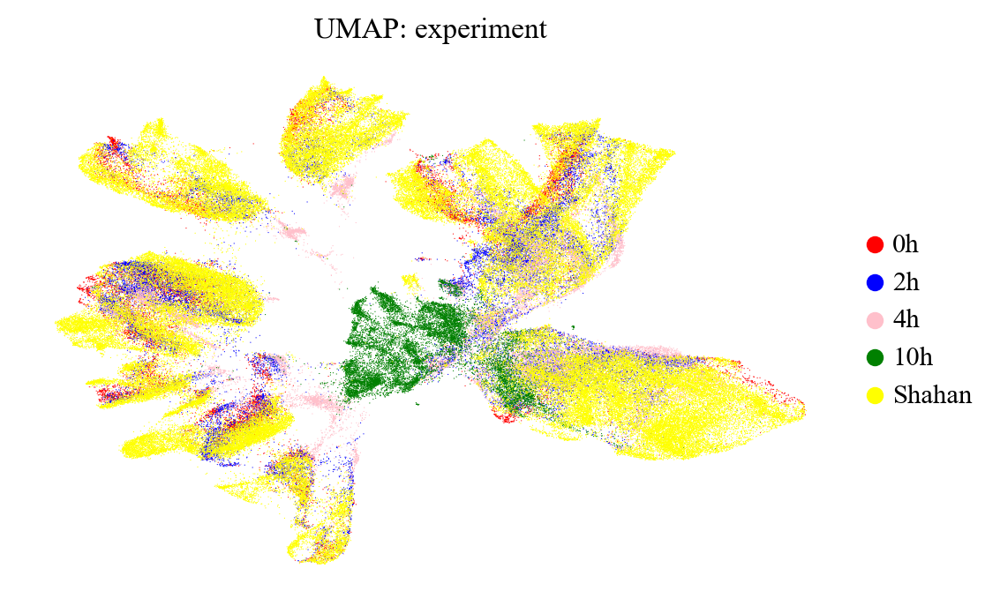

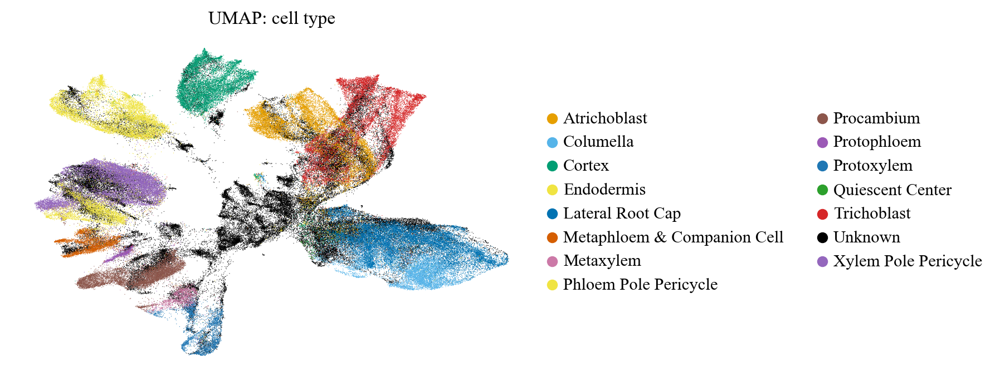

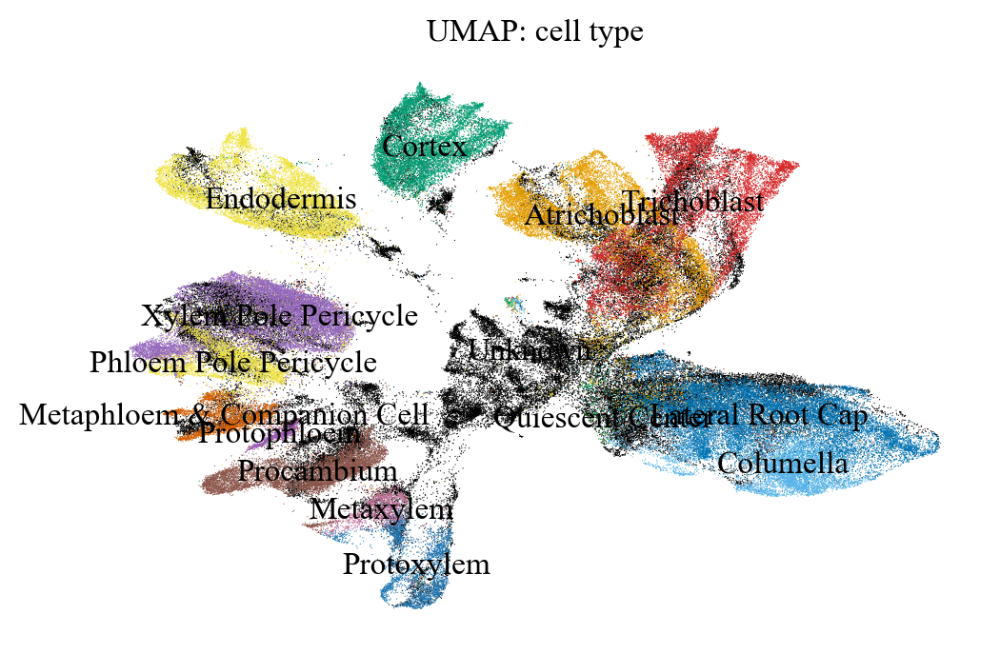

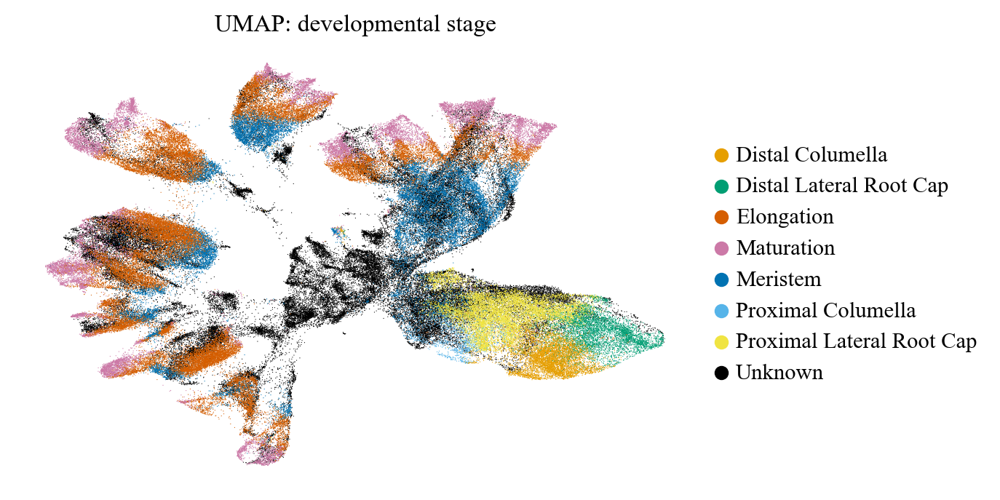

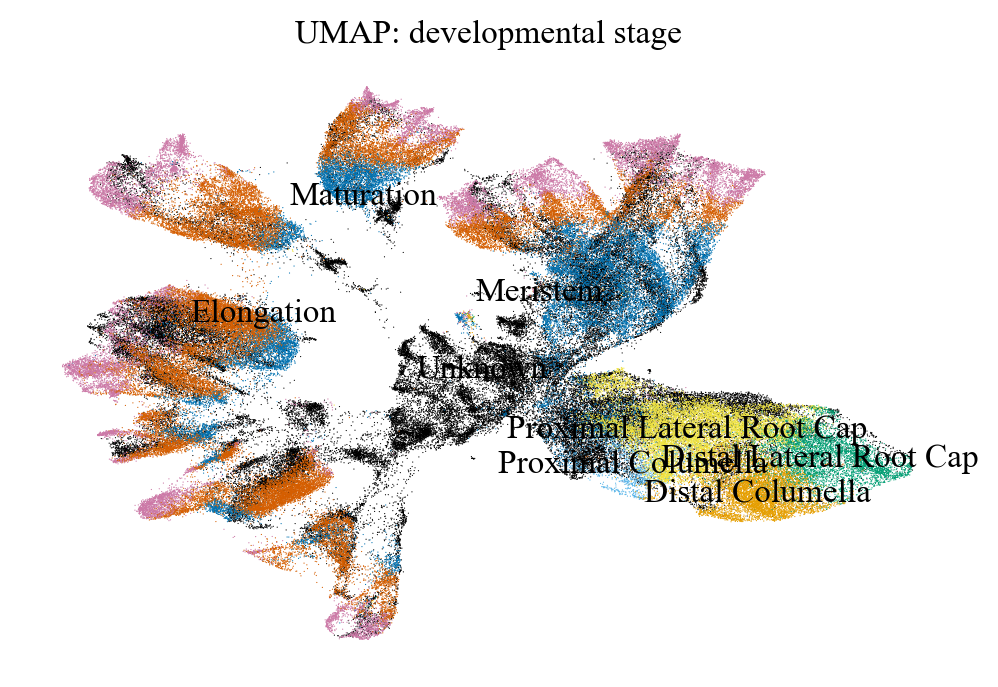

In [7]:
# Plot UMAPs
custom_palette_celltype = {
    "Atrichoblast": "#E69F00", 
    "Columella": "#56B4E9", 
    "Cortex": "#009E73", 
    "Endodermis": "#F0E442", 
    "Lateral Root Cap": "#0072B2", 
    "Metaphloem & Companion Cell": "#D55E00", 
    "Metaxylem": "#CC79A7", 
    "Phloem Pole Pericycle": "#F0E442", 
    "Procambium": "#8C564B", 
    "Protophloem": "#9B59B6", 
    "Protoxylem": "#1F77B4", 
    "Quiescent Center": "#2CA02C",
    "Trichoblast": "#D62728", 
    "Unknown": "#000000",
    "Xylem Pole Pericycle": "#9467BD"
}

custom_palette_developmental = {
    "Distal Columella": "#E69F00", 
    "Proximal Columella": "#56B4E9", 
    "Distal Lateral Root Cap": "#009E73", 
    "Proximal Lateral Root Cap": "#F0E442", 
    "Meristem": "#0072B2", 
    "Elongation": "#D55E00", 
    "Maturation": "#CC79A7", 
    "Unknown": "#000000",
}

sc.pl.umap(adata, color="experiment", palette=['red', 'blue', 'pink', 'green', 'yellow'], frameon=False, title="UMAP: experiment")
sc.pl.umap(adata, layer = "scVI", color=['shahan_celltype'], palette=custom_palette_celltype, frameon=False, title="UMAP: cell type")
sc.pl.umap(adata, layer = "scVI", color=['shahan_celltype'], palette=custom_palette_celltype, legend_loc='on data', frameon=False, title="UMAP: cell type")
sc.pl.umap(adata, layer = "scVI", color=['shahan_developmental'], palette=custom_palette_developmental, frameon=False, title="UMAP: developmental stage")
sc.pl.umap(adata, layer = "scVI", color=['shahan_developmental'], palette=custom_palette_developmental, legend_loc='on data', frameon=False, title="UMAP: developmental stage")

**scVI hyperparameter tuning**

In [5]:
# Take hyperparameters from script
scvi.model.SCVI.setup_anndata(adata, batch_key='sample')
model_hyperparameter = scvi.model.SCVI(adata, n_hidden=256, n_layers=3, n_latent=20, dispersion="gene-cell", gene_likelihood="nb")

In [6]:
# Moves model to the first available GPU (which is now GPU 1)
model_hyperparameter.to_device("cuda:0")
model_hyperparameter.train(max_epochs=100, check_val_every_n_epoch=1, train_size=0.9, validation_size=0.1, early_stopping=True, \
                            early_stopping_patience=10, batch_size=256, plan_kwargs={"lr": 0.001})

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Training:   0%|          | 0/100 [00:00<?, ?it/s]

`Trainer.fit` stopped: `max_epochs=100` reached.


In [7]:
model_hyperparameter.save('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-1_models/scVI_hyperparameter_tuning.pt') 
adata.write_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/scVI_hyperparameter_tuning.h5ad')

In [8]:
adata_hyperparameter = anndata.read_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/scVI_hyperparameter_tuning.h5ad')
model_hyperparameter = scvi.model.SCVI.load('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-1_models/scVI_hyperparameter_tuning.pt',adata_hyperparameter)

INFO     File                                                                                                      
         /lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-1_models/scVI_hyperparameter_tuning.pt/model.pt
         already downloaded                                                                                        


In [9]:
# Get latent representation
latent = model_hyperparameter.get_latent_representation()
adata_hyperparameter.obsm['X_scVI'] = latent
adata_hyperparameter.layers['scVI'] = model_hyperparameter.get_normalized_expression(library_size=1e4)

In [10]:
# Compute nearest neighbor graph and UMAP
sc.pp.neighbors(adata_hyperparameter, use_rep='X_scVI', random_state=0)
sc.tl.umap(adata_hyperparameter, min_dist=0.3)

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:16)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:01:36)


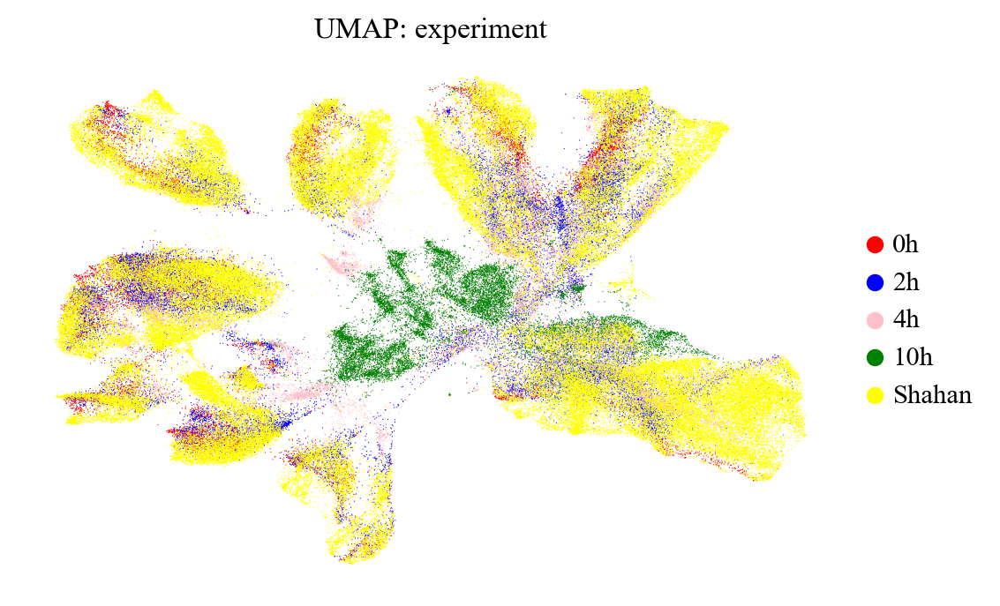

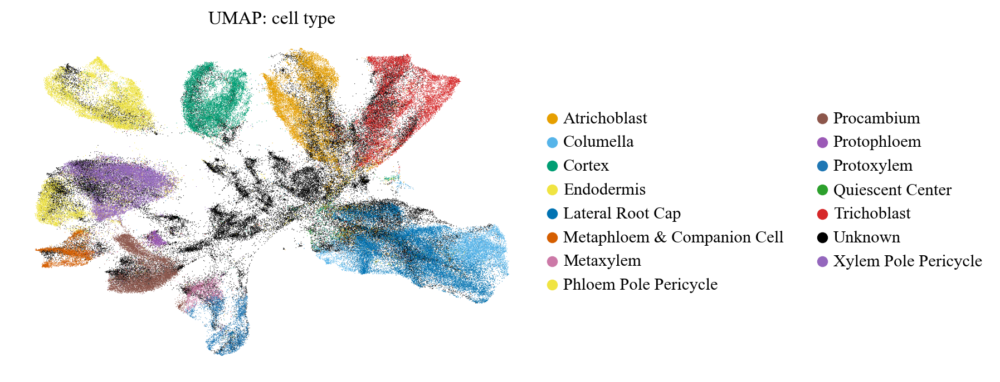

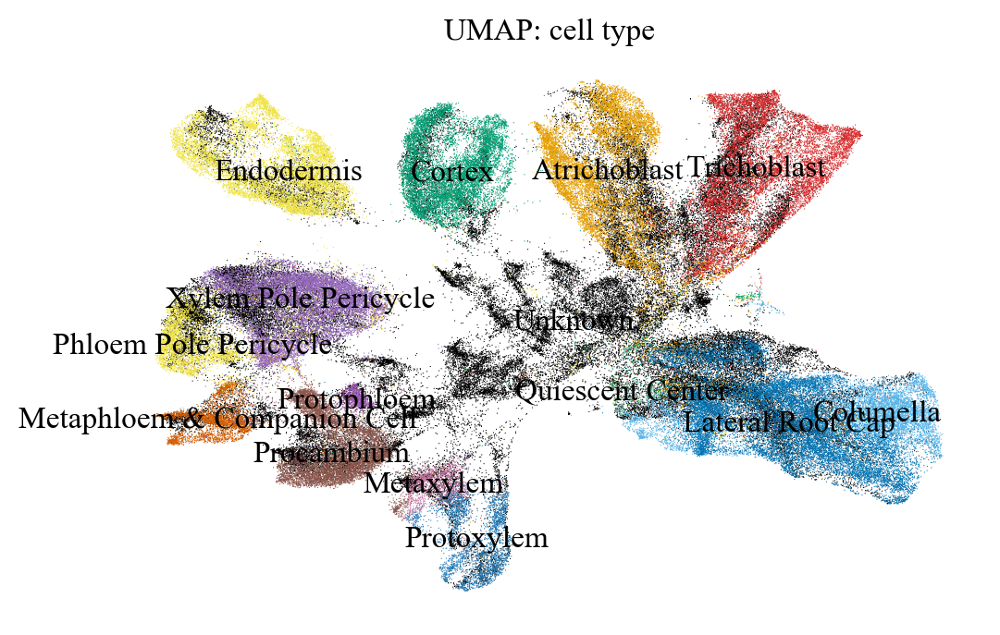

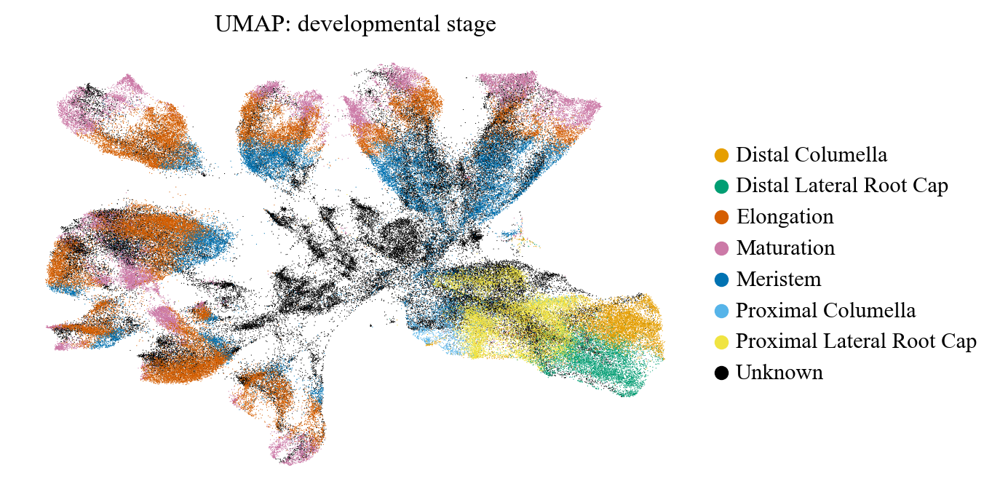

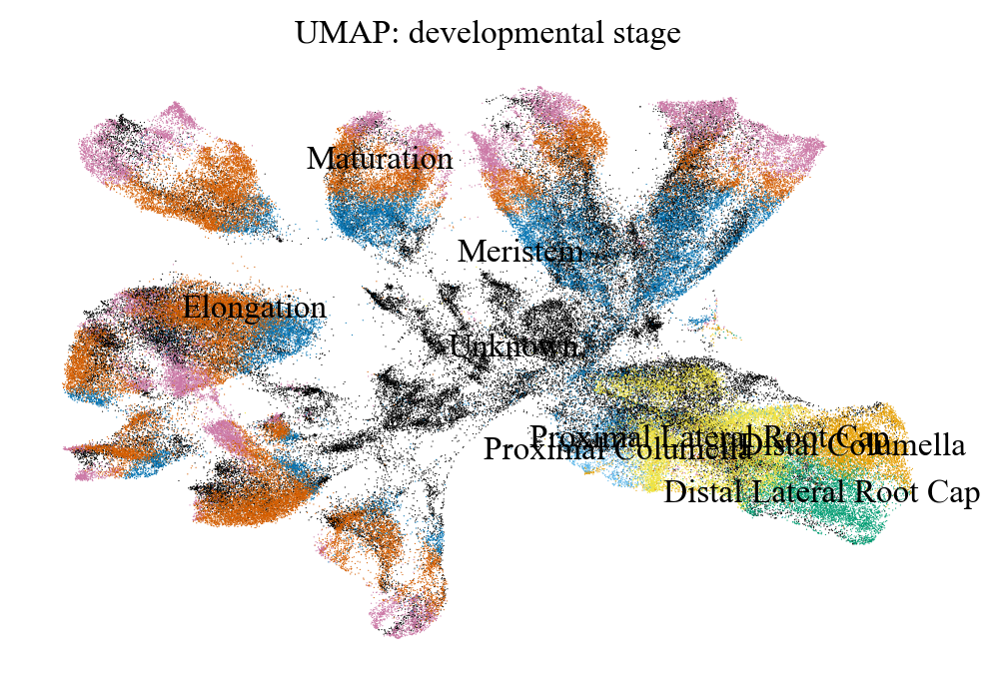

In [11]:
# Plot UMAPs
custom_palette_celltype = {
    "Atrichoblast": "#E69F00", 
    "Columella": "#56B4E9", 
    "Cortex": "#009E73", 
    "Endodermis": "#F0E442", 
    "Lateral Root Cap": "#0072B2", 
    "Metaphloem & Companion Cell": "#D55E00", 
    "Metaxylem": "#CC79A7", 
    "Phloem Pole Pericycle": "#F0E442", 
    "Procambium": "#8C564B", 
    "Protophloem": "#9B59B6", 
    "Protoxylem": "#1F77B4", 
    "Quiescent Center": "#2CA02C",
    "Trichoblast": "#D62728", 
    "Unknown": "#000000",
    "Xylem Pole Pericycle": "#9467BD"
}

custom_palette_developmental = {
    "Distal Columella": "#E69F00", 
    "Proximal Columella": "#56B4E9", 
    "Distal Lateral Root Cap": "#009E73", 
    "Proximal Lateral Root Cap": "#F0E442", 
    "Meristem": "#0072B2", 
    "Elongation": "#D55E00", 
    "Maturation": "#CC79A7", 
    "Unknown": "#000000",
}

sc.pl.umap(adata_hyperparameter, color="experiment", palette=['red', 'blue', 'pink', 'green', 'yellow'], frameon=False, title="UMAP: experiment")
sc.pl.umap(adata_hyperparameter, layer = "scVI", color=['shahan_celltype'], palette=custom_palette_celltype, frameon=False, title="UMAP: cell type")
sc.pl.umap(adata_hyperparameter, layer = "scVI", color=['shahan_celltype'], palette=custom_palette_celltype, legend_loc='on data', frameon=False, title="UMAP: cell type")
sc.pl.umap(adata_hyperparameter, layer = "scVI", color=['shahan_developmental'], palette=custom_palette_developmental, frameon=False, title="UMAP: developmental stage")
sc.pl.umap(adata_hyperparameter, layer = "scVI", color=['shahan_developmental'], palette=custom_palette_developmental, legend_loc='on data', frameon=False, title="UMAP: developmental stage")

**Comparison scVI models**

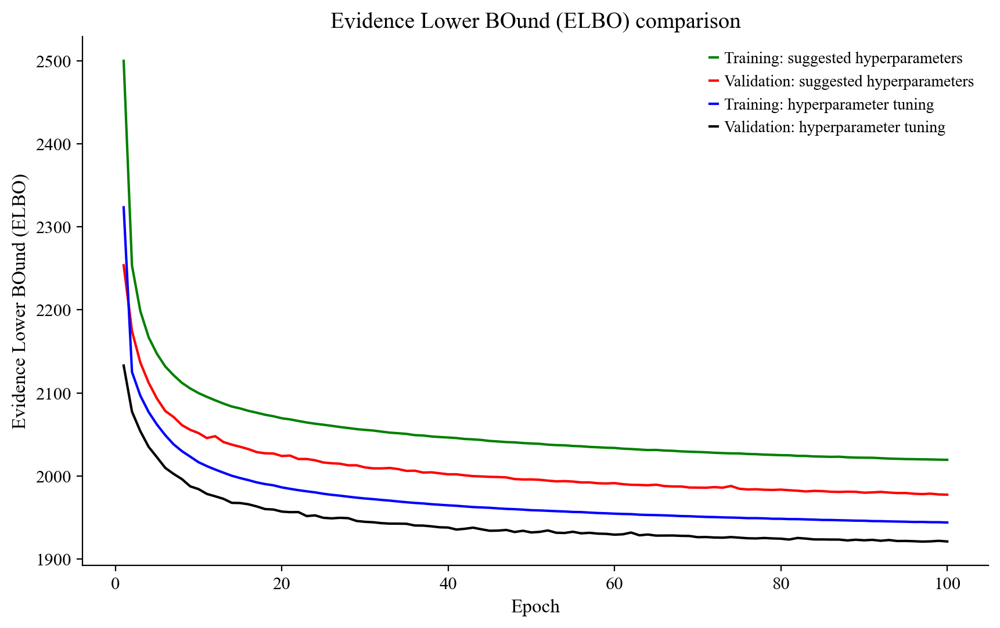

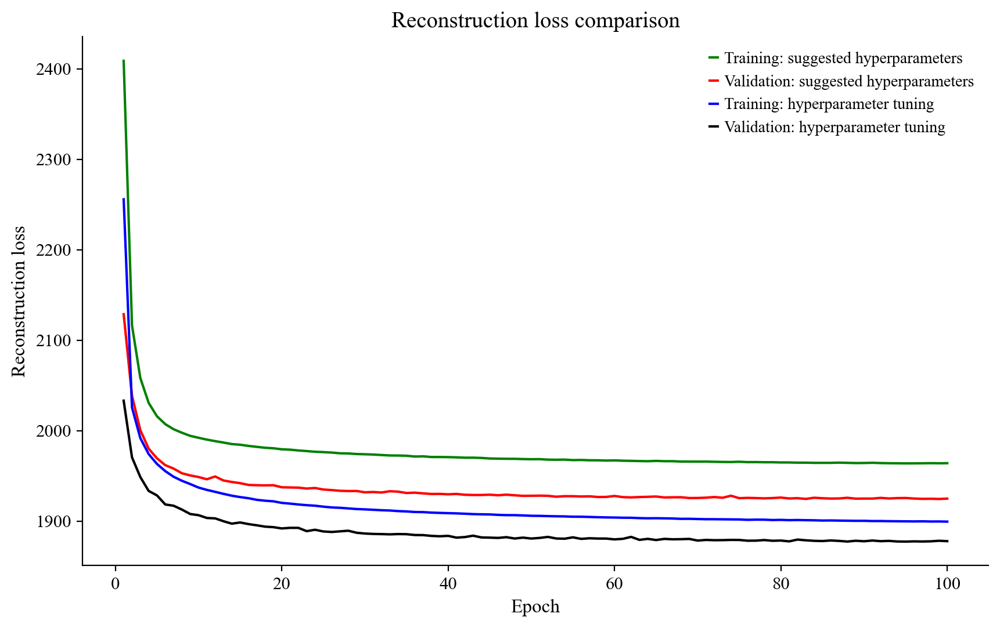

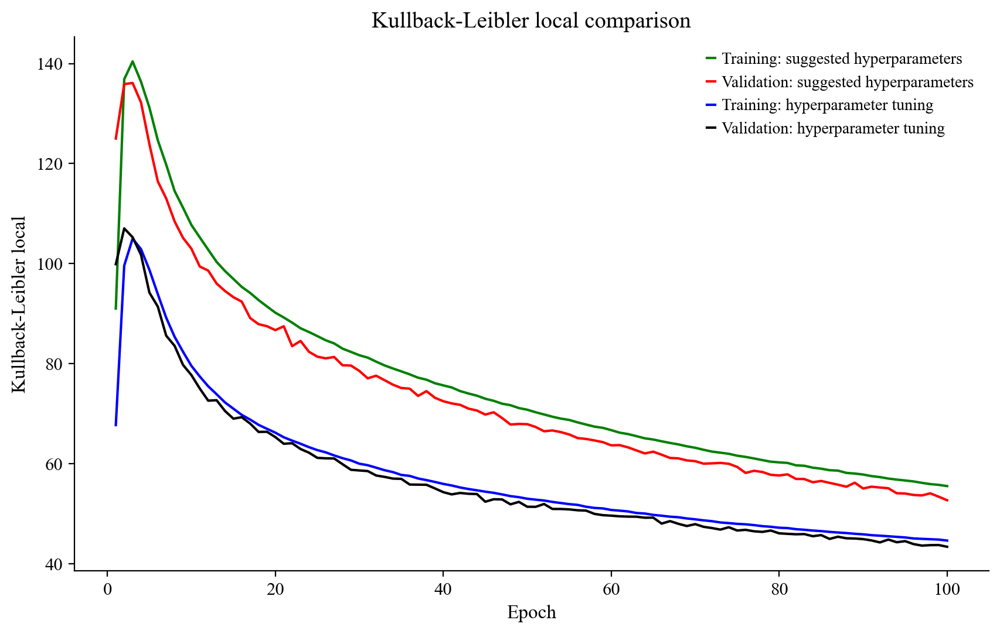

In [13]:
# Extract metrics for ELBO, reconstruction loss, and KL local
metrics = {
    "Evidence Lower BOund (ELBO)": {
        "train_suggested": model.history['elbo_train'],
        "val_suggested": model.history['elbo_validation'],
        "train_tuned": model_hyperparameter.history['elbo_train'],
        "val_tuned": model_hyperparameter.history['elbo_validation']
    },
    "Reconstruction loss": {
        "train_suggested": model.history['reconstruction_loss_train'],
        "val_suggested": model.history['reconstruction_loss_validation'],
        "train_tuned": model_hyperparameter.history['reconstruction_loss_train'],
        "val_tuned": model_hyperparameter.history['reconstruction_loss_validation']
    },
    "Kullback-Leibler local": {
        "train_suggested": model.history['kl_local_train'],
        "val_suggested": model.history['kl_local_validation'],
        "train_tuned": model_hyperparameter.history['kl_local_train'],
        "val_tuned": model_hyperparameter.history['kl_local_validation']
    }
}

for metric_name, metric_values in metrics.items():
    fig, ax = pl.subplots(figsize=(10, 6))
    
    # Create epoch lists
    epochs_suggested = list(range(1, len(metric_values['train_suggested']) + 1))
    epochs_tuned = list(range(1, len(metric_values['train_tuned']) + 1))
    
    # Ensure arrays are correctly shaped
    metric_values = {key: value.squeeze() for key, value in metric_values.items()}
    
    # Plot training and validation together
    sns.lineplot(x=epochs_suggested, y=metric_values['train_suggested'], label=f'Training: suggested hyperparameters', color='green', ax=ax)
    sns.lineplot(x=epochs_suggested, y=metric_values['val_suggested'], label=f'Validation: suggested hyperparameters', color='red', ax=ax)
    sns.lineplot(x=epochs_tuned, y=metric_values['train_tuned'], label=f'Training: hyperparameter tuning', color='blue', ax=ax)
    sns.lineplot(x=epochs_tuned, y=metric_values['val_tuned'], label=f'Validation: hyperparameter tuning', color='black', ax=ax)
    
    # Set labels
    ax.set_title(f'{metric_name} comparison', fontsize=14)
    ax.set_xlabel('Epoch', fontsize=12)
    ax.set_ylabel(metric_name, fontsize=12)
    
    # Add a legend without frame
    ax.legend(loc='upper right', fontsize=10, frameon=False)
    
    # Remove the frame of the plot, but leave the axes
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['left'].set_visible(True)
    ax.spines['bottom'].set_visible(True)
    
    pl.show()



**scANVI: cell type prediction**

In [9]:
scanvi_model = scvi.model.SCANVI.from_scvi_model(model_hyperparameter, "Unknown", labels_key="shahan_celltype")

In [10]:
# Moves model to the first available GPU (which is now GPU 1)
scanvi_model.to_device("cuda:0")
scanvi_model.train(max_epochs=100, check_val_every_n_epoch=1, batch_size=127, train_size=0.9, \
                    validation_size=0.1, early_stopping=True, early_stopping_patience=5)

INFO     Training for 100 epochs.                                                                                  


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Training:   0%|          | 0/100 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 5 records. Best score: 1945.639. Signaling Trainer to stop.


In [13]:
scanvi_model.save('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-1_models/scANVI_celltype.pt') 
adata_hyperparameter.write_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/scANVI_celltype.h5ad')

In [4]:
adata_scanvi = anndata.read_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/scANVI_celltype.h5ad')
scanvi_model = scvi.model.SCANVI.load('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-1_models/scANVI_celltype.pt',adata_scanvi)

INFO     File /lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-1_models/scANVI_celltype.pt/model.pt      
         already downloaded                                                                                        


In [5]:
# Get latent representation and predict probabilities per cell for each cell type
SCANVI_LATENT_KEY = "X_scANVI"
SCANVI_PREDICTIONS_KEY = "C_scANVI"

adata_scanvi.obsm[SCANVI_LATENT_KEY] = scanvi_model.get_latent_representation(adata_scanvi)
adata_scanvi.obsm[SCANVI_PREDICTIONS_KEY] = scanvi_model.predict(adata_scanvi, soft = True)

In [6]:
# Define a function to assign the final annotation based on a threshold
def assign_annotation(row, threshold):
    max_prob = row.max()
    return row.idxmax() if max_prob > threshold else 'Unannotated'

# Define different thresholds
thresholds = [0.7, 0.8, 0.9]

# Apply the function across all cells for each threshold and store results
for threshold in thresholds:
    adata_scanvi.obs[f'final_annotation_celltype_{threshold}'] = adata_scanvi.obsm[SCANVI_PREDICTIONS_KEY].apply(assign_annotation, axis=1, threshold=threshold)

In [7]:
# Define a function to assign the two most likely cell types for unannotated cells
def get_two_likely_types(row, threshold=0.7):
    sorted_probs = row.sort_values(ascending=False)  # Sort probabilities in descending order
    max_prob = sorted_probs.iloc[0]
    top_two_max_prob = sorted_probs.iloc[0] + sorted_probs.iloc[1]
    
    if max_prob > threshold:
        return "Annotated"  # Skip if already annotated
    elif top_two_max_prob < threshold:
        return "Mixed identity"
    
    # Get the two most likely cell types
    top_two_types = sorted_probs.index[:2]
    
    return '+'.join(top_two_types)

# Apply the function to retrieve two most likely cell types for unannotated cells
adata_scanvi.obs['unannotated_2_likely'] = adata_scanvi.obsm[SCANVI_PREDICTIONS_KEY].apply(get_two_likely_types, axis=1)

In [8]:
# Function to standardize category order, for example, Atrichoblast+Trichoblast and Trichoblast+Atrichoblast will become the same category
def standardize_category(category):
    if pd.isna(category):  # Handle NaN cases
        return category
    cell_types = category.split("+")  # Split into two words
    return "+".join(sorted(cell_types))  # Sort and rejoin

# Apply function to create a new observation with merged categories
adata_scanvi.obs['unannotated_2_likely_merged'] = adata_scanvi.obs['unannotated_2_likely'].apply(standardize_category)

# Count occurrences of the new merged categories
merged_counts = adata_scanvi.obs['unannotated_2_likely_merged'].value_counts()

# Display the result
print(merged_counts)

Annotated                                 160728
Atrichoblast+Trichoblast                     763
Cortex+Endodermis                            402
Columella+Lateral Root Cap                   324
Atrichoblast+Lateral Root Cap                313
                                           ...  
Endodermis+Metaphloem & Companion Cell         1
Lateral Root Cap+Phloem Pole Pericycle         1
Quiescent Center+Trichoblast                   1
Phloem Pole Pericycle+Protoxylem               1
Lateral Root Cap+Quiescent Center              1
Name: unannotated_2_likely_merged, Length: 79, dtype: int64


In [9]:
# Map the two most likely predictions to a lineage category
def map_to_lineage(cell_types):
    if pd.isna(cell_types):  # Skip if cell has NaN
        return None
    
    # Check for specific combinations and map them to the correct lineage
    if "Lateral Root Cap" in cell_types and "Columella" in cell_types:
        return "Root Cap"
    elif "Atrichoblast" in cell_types and "Trichoblast" in cell_types:
        return "Epidermis"
    elif "Cortex" in cell_types and "Endodermis" in cell_types:
        return "Ground Tissue"
    elif any(x in cell_types for x in ["Metaphloem", "Companion Cell", "Metaxylem", "Phloem Pole Pericycle", 
                                        "Procambium", "Protophloem", "Protoxylem", "Xylem Pole Pericycle"]):
        return "Stele"
    else:
        return "Mixed identity"  # If it doesn't match any of the defined categories

# Apply the function to determine the lineage for unannotated cells skipping cells that are already annotated
adata_scanvi.obs['lineage_low_confidence'] = adata_scanvi.obs['unannotated_2_likely_merged'].apply(
    lambda x: map_to_lineage(x) if x != "Annotated" else None
)

# Display the results to verify the correct lineage assignments
print(adata_scanvi.obs["lineage_low_confidence"].value_counts())

Stele             1653
Mixed identity    1330
Epidermis          763
Ground Tissue      402
Root Cap           324
Name: lineage_low_confidence, dtype: int64


In [10]:
def update_final_lineages(row):
    # If the lineage is None, check the cell type in final_annotation_celltype_0.7
    if row['lineage_low_confidence'] is None:
        cell_type = row['final_annotation_celltype_0.7']
        
        # Map based on specific cell types
        if cell_type in ["Lateral Root Cap", "Columella"]:
            return "Root Cap"
        elif cell_type in ["Atrichoblast", "Trichoblast"]:
            return "Epidermis"
        elif cell_type in ["Cortex", "Endodermis"]:
            return "Ground Tissue"
        elif any(x in cell_type for x in ["Metaphloem", "Companion Cell", "Metaxylem", "Phloem Pole Pericycle",
                                          "Procambium", "Protophloem", "Protoxylem", "Xylem Pole Pericycle"]):
            return "Stele"
        else:
            return None  # Return None if it doesn't match any of the conditions
    else:
        return row['lineage_low_confidence']  # Return the existing value if not None

# Apply the function to create the 'final_lineages' column
adata_scanvi.obs['final_lineages'] = adata_scanvi.obs.apply(update_final_lineages, axis=1)

# Display the results to verify the correct lineage assignments
print(adata_scanvi.obs["final_lineages"].value_counts())

Stele             55553
Epidermis         41751
Root Cap          36232
Ground Tissue     30164
Mixed identity     1330
Name: final_lineages, dtype: int64


In [11]:
# General color palette for both cell type and developmental stage annotations
general_palette = {
    # Cell types
    "Atrichoblast": "#E69F00", 
    "Columella": "#56B4E9", 
    "Cortex": "#009E73", 
    "Endodermis": "#F0E442", 
    "Lateral Root Cap": "#0072B2", 
    "Metaphloem & Companion Cell": "#D55E00", 
    "Metaxylem": "#CC79A7", 
    "Phloem Pole Pericycle": "#F0E442", 
    "Procambium": "#8C564B", 
    "Protophloem": "#9B59B6", 
    "Protoxylem": "#1F77B4", 
    "Quiescent Center": "#2CA02C",
    "Trichoblast": "#D62728", 
    "Xylem Pole Pericycle": "#9467BD",

    # Developmental stages
    "Distal Columella": "#E69F00", 
    "Proximal Columella": "#56B4E9", 
    "Distal Lateral Root Cap": "#009E73", 
    "Proximal Lateral Root Cap": "#F0E442", 
    "Meristem": "#0072B2", 
    "Elongation": "#D55E00", 
    "Maturation": "#CC79A7",

    # Shared
    "Unannotated": "#000000"
}

In [12]:
def prediction_percentage(adata, confidence_level, mode="celltype"):
    if mode == "celltype":
        annotation_col = f"final_annotation_celltype_{confidence_level}"
        y_label = "Cell type percentage"
        title = "Preliminary cell type prediction"

    elif mode == "developmental":
        annotation_col = f"final_annotation_developmental_{confidence_level}"
        y_label = "Developmental stage percentage"
        title = "Preliminary developmental stage prediction"

    else:
        raise ValueError("Invalid mode. Use 'celltype' or 'developmental'.")

    # Step 1: Count cells per sample and type
    cell_counts = adata.obs.groupby(["experiment", "sample", annotation_col]).size().reset_index(name="cell_count")

    # Step 2: Total cells per sample
    total_cells_per_sample = adata.obs.groupby("sample").size().reset_index(name="total_cells")

    # Step 3: Merge to get percentage
    cell_counts = cell_counts.merge(total_cells_per_sample, on="sample")

    # Step 4: Total cells per experiment
    total_cells_per_experiment = adata.obs.groupby("experiment").size().reset_index(name="experiment_total_cells")

    # Step 5: Sum cells per type per experiment
    cell_type_per_experiment = cell_counts.groupby(["experiment", annotation_col]).agg(
        total_cell_type_count=("cell_count", "sum")
    ).reset_index()

    # Step 6: Merge total counts
    cell_type_per_experiment = cell_type_per_experiment.merge(total_cells_per_experiment, on="experiment")

    # Step 7: Calculate percentage
    cell_type_per_experiment["percentage"] = (
        cell_type_per_experiment["total_cell_type_count"] / cell_type_per_experiment["experiment_total_cells"]
    ) * 100

    # Step 8: Plot
    pl.figure(figsize=(14, 8))
    sns.barplot(
        data=cell_type_per_experiment,
        x="experiment",
        y="percentage",
        hue=annotation_col,
        palette=general_palette
    )
    pl.xlabel("")
    pl.ylabel(y_label, fontsize=14)
    pl.tick_params(axis='both', labelsize=14)
    sns.despine(top=True, right=True)
    pl.legend(bbox_to_anchor=(1.05, 0.5), loc="center left", frameon=False, fontsize=12)
    pl.title(title, fontsize=18)
    pl.tight_layout()
    pl.show()


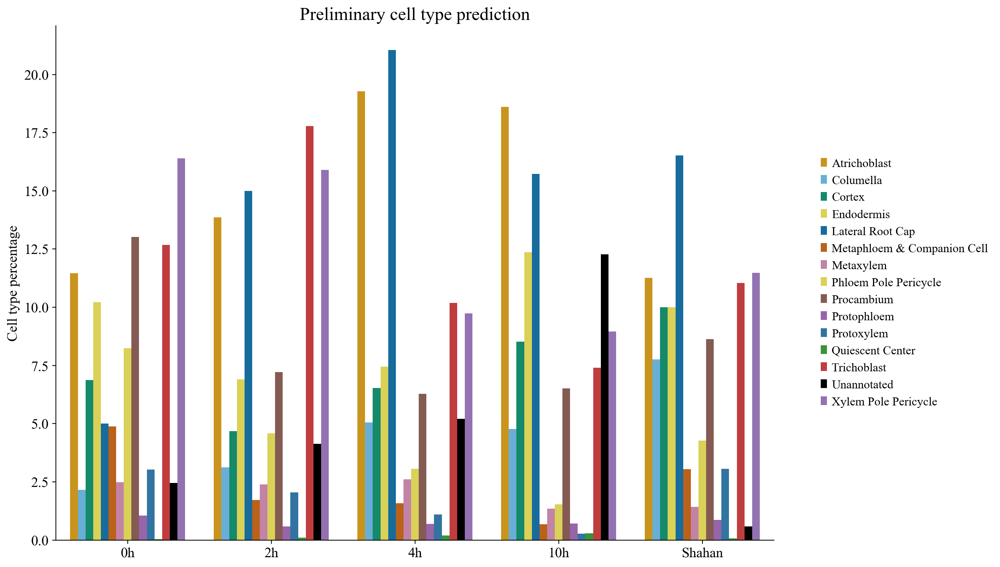

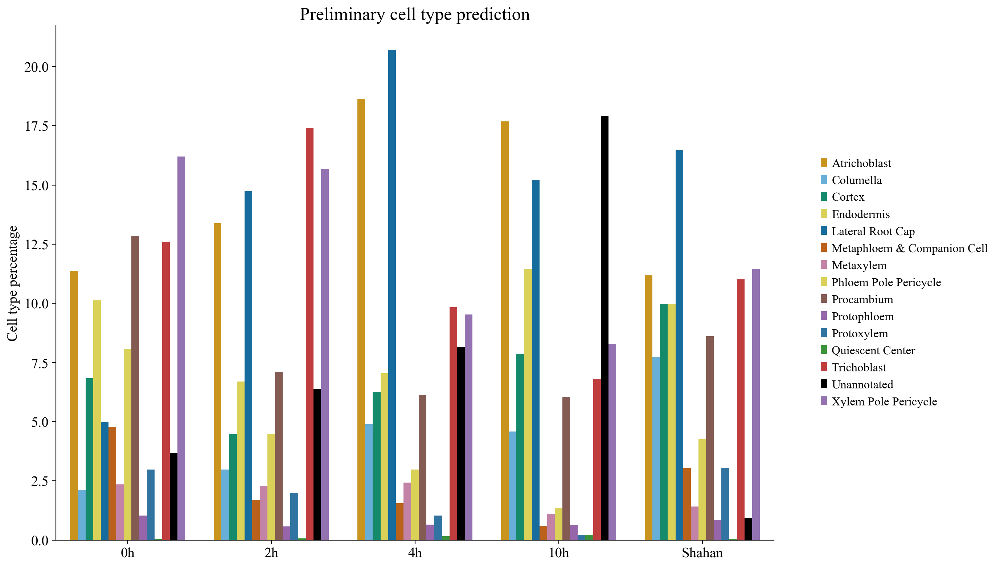

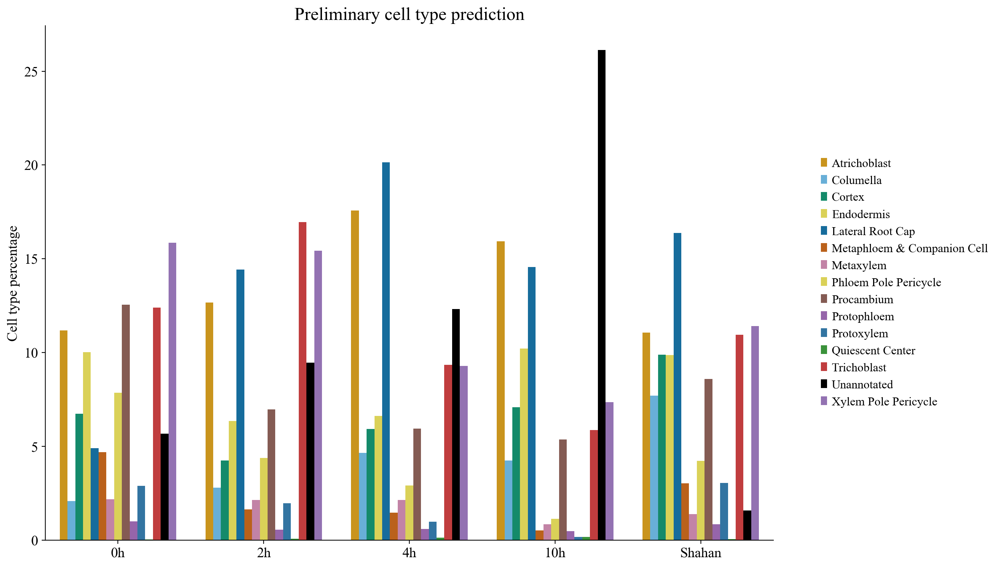

In [13]:
for confidence in [0.7, 0.8, 0.9]:
    prediction_percentage(adata_scanvi, confidence, mode="celltype")

In [14]:
def confusion_matrix(
    model: scvi.model.SCANVI,  
    mode: str = "celltype",  # or "developmental"
    subset: str | None = None,
    confidence: float = 0.7,
    prediction_key: str = "_prediction"
):
    fig, ax = pl.subplots(figsize=(6, 6))

    adata = model.adata

    # Set keys and title based on mode
    if mode == "celltype":
        labels_key = "shahan_celltype"
        final_annotation_key = f"final_annotation_celltype_{confidence}"
        title = "Cell type prediction"
    elif mode == "developmental":
        labels_key = "shahan_developmental"
        final_annotation_key = f"final_annotation_developmental_{confidence}"
        title = "Developmental stage prediction"
    else:
        raise ValueError("Mode must be 'celltype' or 'developmental'")

    # Copy predictions into obs
    adata.obs[prediction_key] = adata.obs[final_annotation_key]

    # Apply subset if provided
    if subset == "validation":
        adata = adata[model.validation_indices].copy()
    elif subset == "train":
        adata = adata[model.train_indices].copy()

    # Filter out 'Unknown' true labels
    adata = adata[adata.obs[labels_key] != "Unknown"]

    # Compute normalized confusion matrix
    df = adata.obs.groupby([labels_key, prediction_key]).size().unstack(fill_value=0)
    conf_mat = df / df.sum(axis=1).values[:, np.newaxis]

    # Plot heatmap
    cax = ax.imshow(conf_mat, cmap="viridis", aspect="auto", interpolation="nearest")
    pl.colorbar(cax, ax=ax, label="Frequency")

    ax.set_xticks(np.arange(len(df.columns)))
    ax.set_xticklabels(df.columns, rotation=45, ha="right", rotation_mode="anchor")

    ax.set_yticks(np.arange(len(df.index)))
    ax.set_yticklabels(df.index)

    ax.set_title(title)
    ax.set_xlabel("Predicted", fontsize=12, labelpad=10)
    ax.set_ylabel("Observed", fontsize=12, labelpad=10)

    fig.tight_layout()
    pl.show()

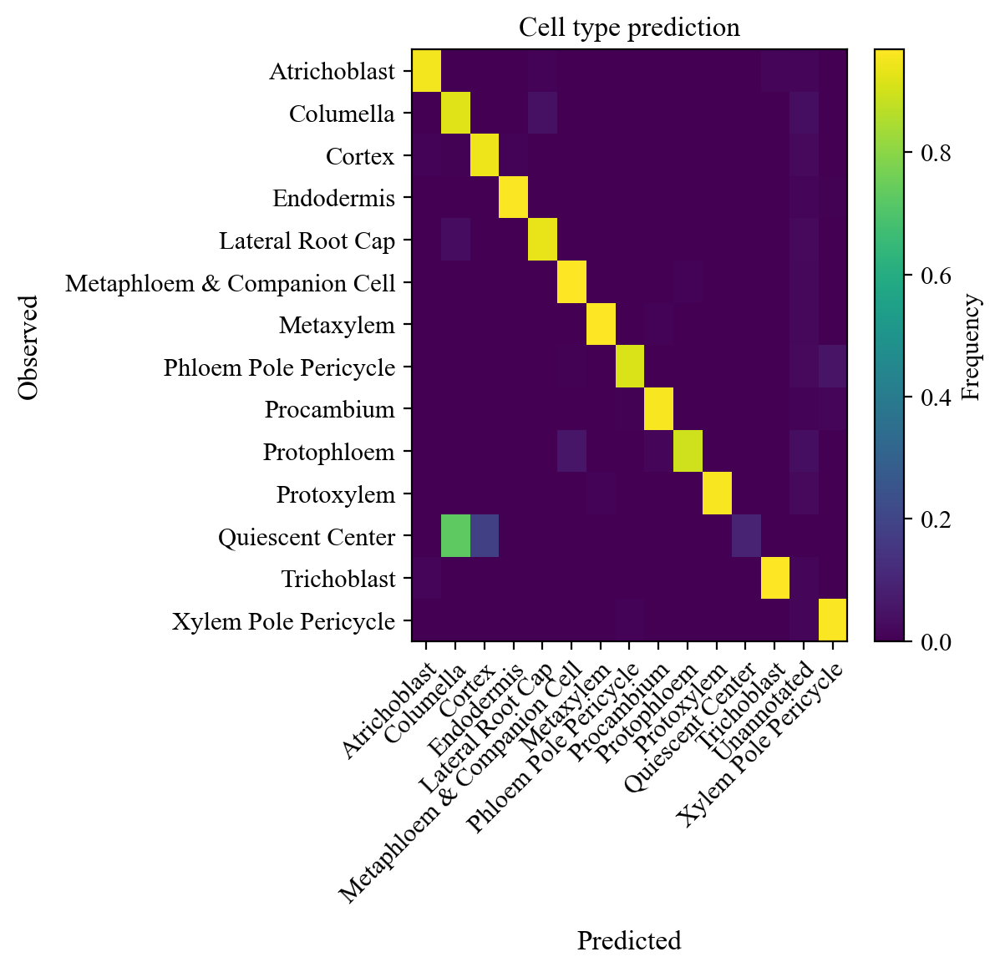

In [15]:
confusion_matrix(scanvi_model, mode="celltype", subset="validation", confidence=0.7)

**scanVI: developmental stage prediction**

In [9]:
scanvi_developmental = scvi.model.SCANVI.from_scvi_model(model_hyperparameter, "Unknown", labels_key="shahan_developmental")

In [10]:
# Moves model to the first available GPU (which is now GPU 1)
scanvi_developmental.to_device("cuda:0")
scanvi_developmental.train(max_epochs=100, check_val_every_n_epoch=1, batch_size=127, train_size=0.9, \
                           validation_size=0.1, early_stopping=True, early_stopping_patience=5)

INFO     Training for 100 epochs.                                                                                  


GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [1]


Training:   0%|          | 0/100 [00:00<?, ?it/s]

Monitored metric elbo_validation did not improve in the last 5 records. Best score: 1949.495. Signaling Trainer to stop.


In [11]:
scanvi_developmental.save('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-1_models/scANVI_developmental_stage.pt') 
adata_hyperparameter.write_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/scANVI_developmental_stage.h5ad')

In [16]:
adata_scanvi_developmental = anndata.read_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/scANVI_developmental_stage.h5ad')
scanvi_developmental = scvi.model.SCANVI.load('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-1_models/scANVI_developmental_stage.pt',adata_scanvi_developmental)

INFO     File                                                                                                      
         /lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-1_models/scANVI_developmental_stage.pt/model.pt
         already downloaded                                                                                        


In [17]:
SCANVI_LATENT_KEY = "X_scANVI"
SCANVI_PREDICTIONS_KEY = "C_scANVI"

adata_scanvi_developmental.obsm[SCANVI_LATENT_KEY] = scanvi_developmental.get_latent_representation(adata_scanvi_developmental)
adata_scanvi_developmental.obsm[SCANVI_PREDICTIONS_KEY] = scanvi_developmental.predict(adata_scanvi_developmental, soft = True)

In [18]:
# Assume these are your soft predictions, where columns are cell types.
soft_preds = scanvi_developmental.predict(adata_scanvi_developmental, soft=True)

# Define a function to assign the final annotation based on a threshold
def assign_annotation(row, threshold):
    max_prob = row.max()
    return row.idxmax() if max_prob > threshold else 'Unannotated'

# Define different thresholds
thresholds = [0.7, 0.8, 0.9]

# Apply the function across all cells for each threshold and store results
for threshold in thresholds:
    adata_scanvi_developmental.obs[f'final_annotation_developmental_{threshold}'] = soft_preds.apply(assign_annotation, axis=1, threshold=threshold)

In [19]:
# General color palette for both cell type and developmental stage annotations
general_palette = {
    # Cell types
    "Atrichoblast": "#E69F00", 
    "Columella": "#56B4E9", 
    "Cortex": "#009E73", 
    "Endodermis": "#F0E442", 
    "Lateral Root Cap": "#0072B2", 
    "Metaphloem & Companion Cell": "#D55E00", 
    "Metaxylem": "#CC79A7", 
    "Phloem Pole Pericycle": "#F0E442", 
    "Procambium": "#8C564B", 
    "Protophloem": "#9B59B6", 
    "Protoxylem": "#1F77B4", 
    "Quiescent Center": "#2CA02C",
    "Trichoblast": "#D62728", 
    "Xylem Pole Pericycle": "#9467BD",

    # Developmental stages
    "Distal Columella": "#E69F00", 
    "Proximal Columella": "#56B4E9", 
    "Distal Lateral Root Cap": "#009E73", 
    "Proximal Lateral Root Cap": "#F0E442", 
    "Meristem": "#0072B2", 
    "Elongation": "#D55E00", 
    "Maturation": "#CC79A7",

    # Shared
    "Unannotated": "#000000"
}

In [20]:
def prediction_percentage(adata, confidence_level, mode="celltype"):
    if mode == "celltype":
        annotation_col = f"final_annotation_celltype_{confidence_level}"
        y_label = "Cell type percentage"
        title = "Preliminary cell type prediction"

    elif mode == "developmental":
        annotation_col = f"final_annotation_developmental_{confidence_level}"
        y_label = "Developmental stage percentage"
        title = "Preliminary developmental stage prediction"

    else:
        raise ValueError("Invalid mode. Use 'celltype' or 'developmental'.")

    # Step 1: Count cells per sample and type
    cell_counts = adata.obs.groupby(["experiment", "sample", annotation_col]).size().reset_index(name="cell_count")

    # Step 2: Total cells per sample
    total_cells_per_sample = adata.obs.groupby("sample").size().reset_index(name="total_cells")

    # Step 3: Merge to get percentage
    cell_counts = cell_counts.merge(total_cells_per_sample, on="sample")

    # Step 4: Total cells per experiment
    total_cells_per_experiment = adata.obs.groupby("experiment").size().reset_index(name="experiment_total_cells")

    # Step 5: Sum cells per type per experiment
    cell_type_per_experiment = cell_counts.groupby(["experiment", annotation_col]).agg(
        total_cell_type_count=("cell_count", "sum")
    ).reset_index()

    # Step 6: Merge total counts
    cell_type_per_experiment = cell_type_per_experiment.merge(total_cells_per_experiment, on="experiment")

    # Step 7: Calculate percentage
    cell_type_per_experiment["percentage"] = (
        cell_type_per_experiment["total_cell_type_count"] / cell_type_per_experiment["experiment_total_cells"]
    ) * 100

    # Step 8: Plot
    pl.figure(figsize=(14, 8))
    sns.barplot(
        data=cell_type_per_experiment,
        x="experiment",
        y="percentage",
        hue=annotation_col,
        palette=general_palette
    )
    pl.xlabel("")
    pl.ylabel(y_label, fontsize=14)
    pl.tick_params(axis='both', labelsize=14)
    sns.despine(top=True, right=True)
    pl.legend(bbox_to_anchor=(1.05, 0.5), loc="center left", frameon=False, fontsize=12)
    pl.title(title, fontsize=18)
    pl.tight_layout()
    pl.show()


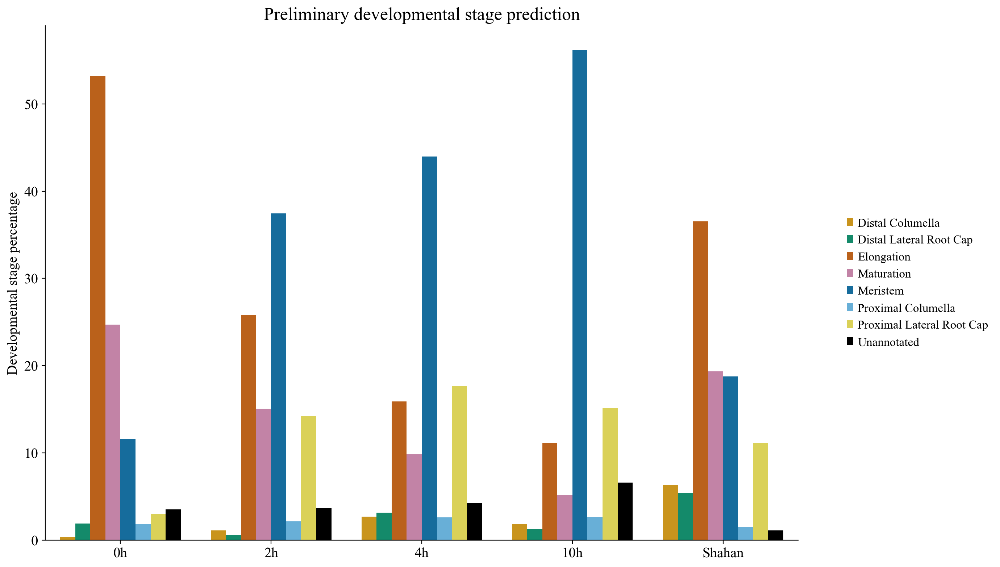

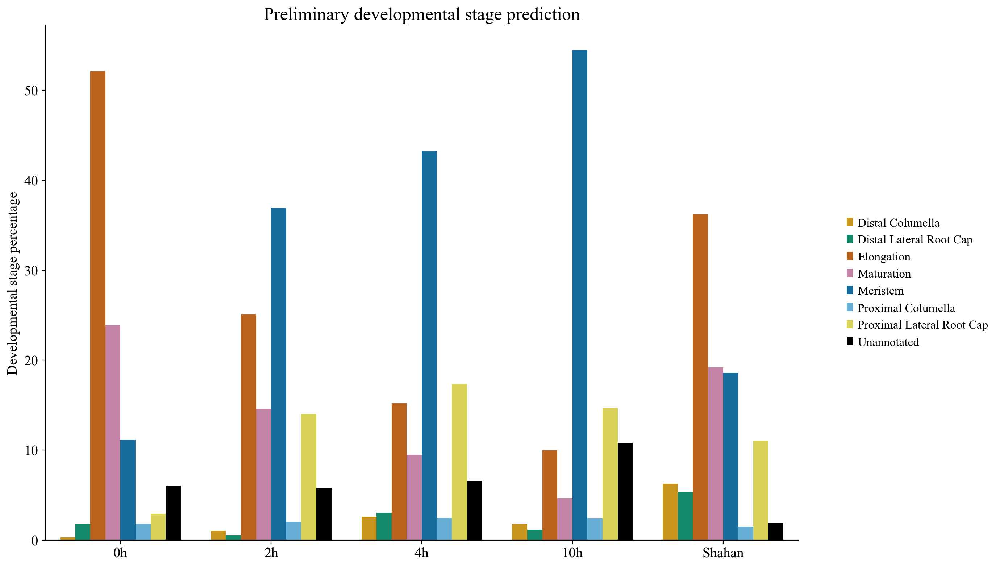

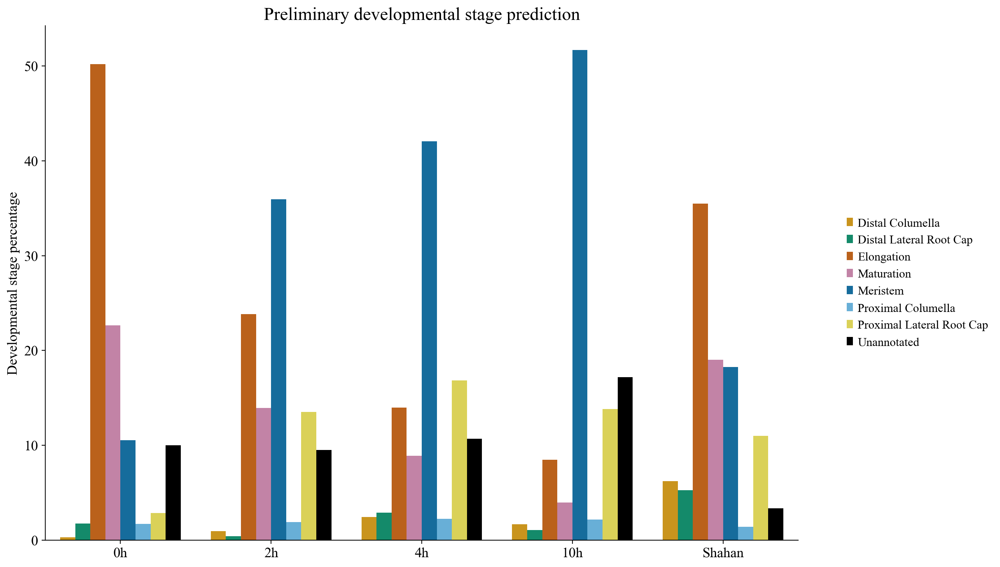

In [21]:
for confidence in [0.7, 0.8, 0.9]:
    prediction_percentage(adata_scanvi_developmental, confidence, mode="developmental")

In [22]:
def confusion_matrix(
    model: scvi.model.SCANVI,  
    mode: str = "celltype",  # or "developmental"
    subset: str | None = None,
    confidence: float = 0.7,
    prediction_key: str = "_prediction"
):
    fig, ax = pl.subplots(figsize=(6, 6))

    adata = model.adata

    # Set keys and title based on mode
    if mode == "celltype":
        labels_key = "shahan_celltype"
        final_annotation_key = f"final_annotation_celltype_{confidence}"
        title = "Cell type prediction"
    elif mode == "developmental":
        labels_key = "shahan_developmental"
        final_annotation_key = f"final_annotation_developmental_{confidence}"
        title = "Developmental stage prediction"
    else:
        raise ValueError("Mode must be 'celltype' or 'developmental'")

    # Copy predictions into obs
    adata.obs[prediction_key] = adata.obs[final_annotation_key]

    # Apply subset if provided
    if subset == "validation":
        adata = adata[model.validation_indices].copy()
    elif subset == "train":
        adata = adata[model.train_indices].copy()

    # Filter out 'Unknown' true labels
    adata = adata[adata.obs[labels_key] != "Unknown"]

    # Compute normalized confusion matrix
    df = adata.obs.groupby([labels_key, prediction_key]).size().unstack(fill_value=0)
    conf_mat = df / df.sum(axis=1).values[:, np.newaxis]

    # Plot heatmap
    cax = ax.imshow(conf_mat, cmap="viridis", aspect="auto", interpolation="nearest")
    pl.colorbar(cax, ax=ax, label="Frequency")

    ax.set_xticks(np.arange(len(df.columns)))
    ax.set_xticklabels(df.columns, rotation=45, ha="right", rotation_mode="anchor")

    ax.set_yticks(np.arange(len(df.index)))
    ax.set_yticklabels(df.index)

    ax.set_title(title)
    ax.set_xlabel("Predicted", fontsize=12, labelpad=10)
    ax.set_ylabel("Observed", fontsize=12, labelpad=10)

    fig.tight_layout()
    pl.show()

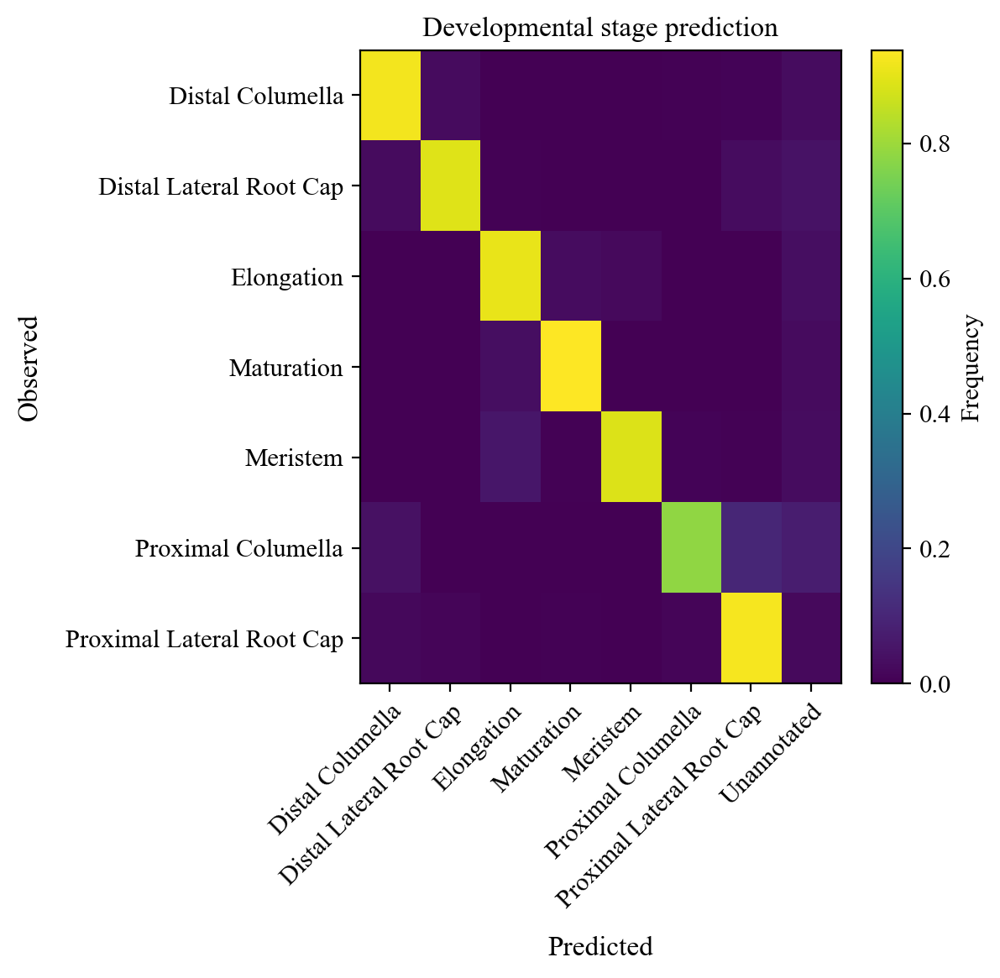

In [23]:
confusion_matrix(scanvi_developmental, mode="developmental", subset="validation", confidence=0.7)

**Merge Anndata objects to remove incompatible cell type-developmental stage combinations**

In [24]:
adata_scanvi.obs["final_annotation_developmental_0.7"] = adata_scanvi_developmental.obs["final_annotation_developmental_0.7"]
adata_scanvi.obs["final_annotation_developmental_0.8"] = adata_scanvi_developmental.obs["final_annotation_developmental_0.8"]
adata_scanvi.obs["final_annotation_developmental_0.9"] = adata_scanvi_developmental.obs["final_annotation_developmental_0.9"]

In [25]:
# Define incompatible developmental stages and required cell type keywords
incompatible_pairs = [
    (["Distal Columella", "Proximal Columella"], "Columella"),
    (["Distal Lateral Root Cap", "Proximal Lateral Root Cap"], "Lateral Root Cap"),
]

# Start with all cells marked as valid
valid_cells = pd.Series(True, index=adata_scanvi.obs.index)

# Iterate over each incompatible combination
for forbidden_stages, required_celltype in incompatible_pairs:
    mask_stage = adata_scanvi.obs["final_annotation_developmental_0.7"].isin(forbidden_stages)
    mask_celltype = adata_scanvi.obs["final_annotation_celltype_0.7"].str.contains(required_celltype, na=False)
    
    # Keep valid cells: either not in forbidden stage or explicitly allowed cell type
    valid_cells &= (~mask_stage | mask_celltype)

# Apply the filter to the AnnData object
adata_scanvi = adata_scanvi[valid_cells]

# Print summary
print(len(adata_scanvi.obs["final_annotation_developmental_0.7"]))
print(adata_scanvi.obs["final_annotation_developmental_0.7"].value_counts())

164308
Elongation                   53403
Meristem                     43656
Maturation                   28178
Proximal Lateral Root Cap    19077
Distal Columella              7004
Distal Lateral Root Cap       6224
Unannotated                   4051
Proximal Columella            2715
Name: final_annotation_developmental_0.7, dtype: int64


In [26]:
# Define the forbidden developmental stages for "Columella" and "Lateral Root Cap"
forbidden_stages = ["Meristem", "Maturation", "Elongation"]
target_celltypes = ["Columella", "Lateral Root Cap"]

# Create a mask for cells with forbidden developmental stages
mask_forbidden_stages = adata_scanvi.obs["final_annotation_developmental_0.7"].isin(forbidden_stages)

# Create a mask for cells with either "Columella" or "Lateral Root Cap" in "final_celltype"
mask_target_celltypes = adata_scanvi.obs["final_annotation_celltype_0.7"].str.contains("Columella|Lateral Root Cap", na=False)

# Combine masks to identify invalid combinations
mask_invalid_combination = mask_forbidden_stages & mask_target_celltypes

# Remove the invalid combinations
adata_scanvi = adata_scanvi[~mask_invalid_combination]

# Print the number of remaining cells and their distribution
print(len(adata_scanvi.obs["final_annotation_developmental_0.7"]))
print(adata_scanvi.obs["final_annotation_developmental_0.7"].value_counts())


164160
Elongation                   53396
Meristem                     43534
Maturation                   28159
Proximal Lateral Root Cap    19077
Distal Columella              7004
Distal Lateral Root Cap       6224
Unannotated                   4051
Proximal Columella            2715
Name: final_annotation_developmental_0.7, dtype: int64


**Keep only target samples (0 to 10 hours)**

In [27]:
adata_my_dataset = adata_scanvi[adata_scanvi.obs['experiment'].isin(['0h', '2h', '4h', '10h'])].copy()

In [28]:
print(adata_my_dataset)
print(adata_my_dataset.obs["final_annotation_celltype_0.7"].value_counts())
print(adata_my_dataset.obs["final_annotation_celltype_0.8"].value_counts())
print(adata_my_dataset.obs["final_annotation_celltype_0.9"].value_counts())
print(adata_my_dataset.obs["final_annotation_developmental_0.7"].value_counts())
print(adata_my_dataset.obs["final_annotation_developmental_0.8"].value_counts())
print(adata_my_dataset.obs["final_annotation_developmental_0.9"].value_counts())
print(adata_my_dataset.obs["final_lineages"].value_counts())

AnnData object with n_obs × n_vars = 68218 × 5000
    obs: 'sample', 'batch', 'experiment', 'shahan_celltype', 'shahan_developmental', '_scvi_batch', '_scvi_labels', 'final_annotation_celltype_0.7', 'final_annotation_celltype_0.8', 'final_annotation_celltype_0.9', 'unannotated_2_likely', 'unannotated_2_likely_merged', 'lineage_low_confidence', 'final_lineages', '_prediction', 'final_annotation_developmental_0.7', 'final_annotation_developmental_0.8', 'final_annotation_developmental_0.9'
    var: 'gene_symbol', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'experiment_colors', 'hvg', 'neighbors', 'shahan_celltype_colors', 'shahan_developmental_colors', 'umap'
    obsm: 'X_scVI', 'X_umap', 'X_scANVI', 'C_scANVI'
    layers: 'scVI'
    obsp: 'connectivities', 'distances'
Atrichoblast                   10744
Lateral Root Cap                9840
Xylem Pole Pericycle            9004
T

In [29]:
# Create a boolean mask to keep only unannotated cells
filtered_mask_07 = adata_my_dataset.obs["final_annotation_celltype_0.7"] == "Unannotated"

# Create a new AnnData object with only unannotated cells
unannotated_cells_07 = adata_my_dataset[filtered_mask_07].copy()

# Check the dimensions of the new dataset
print(f"Original dataset shape: {adata_my_dataset.shape}")
print(f"Filtered dataset shape: {unannotated_cells_07.shape}")

Original dataset shape: (68218, 5000)
Filtered dataset shape: (3488, 5000)


In [30]:
sc.pp.neighbors(unannotated_cells_07, use_rep='X_scANVI')

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:06)


In [31]:
sc.tl.leiden(unannotated_cells_07, key_added="leiden_res0_1", resolution=0.1)
sc.tl.leiden(unannotated_cells_07, key_added="leiden_res0_25", resolution=0.25)
sc.tl.leiden(unannotated_cells_07, key_added="leiden_res0_4", resolution=0.4)
sc.tl.leiden(unannotated_cells_07, key_added="leiden_res0_5", resolution=0.5)
sc.tl.leiden(unannotated_cells_07, key_added="leiden_res0_6", resolution=0.6)
sc.tl.leiden(unannotated_cells_07, key_added="leiden_res0_8", resolution=0.8)
sc.tl.leiden(unannotated_cells_07, key_added="leiden_res1", resolution=1.0)

running Leiden clustering
    finished: found 2 clusters and added
    'leiden_res0_1', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 5 clusters and added
    'leiden_res0_25', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 8 clusters and added
    'leiden_res0_4', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 11 clusters and added
    'leiden_res0_5', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden_res0_6', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 16 clusters and added
    'leiden_res0_8', the cluster labels (adata.obs, categorical) (0:00:00)
running Leiden clustering
    finished: found 17 clusters and added
    'leiden_res1', the cluster labels (adata.obs, categorical) (0:00:00)


In [32]:
sc.tl.umap(unannotated_cells_07, min_dist=0.3)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:00:04)


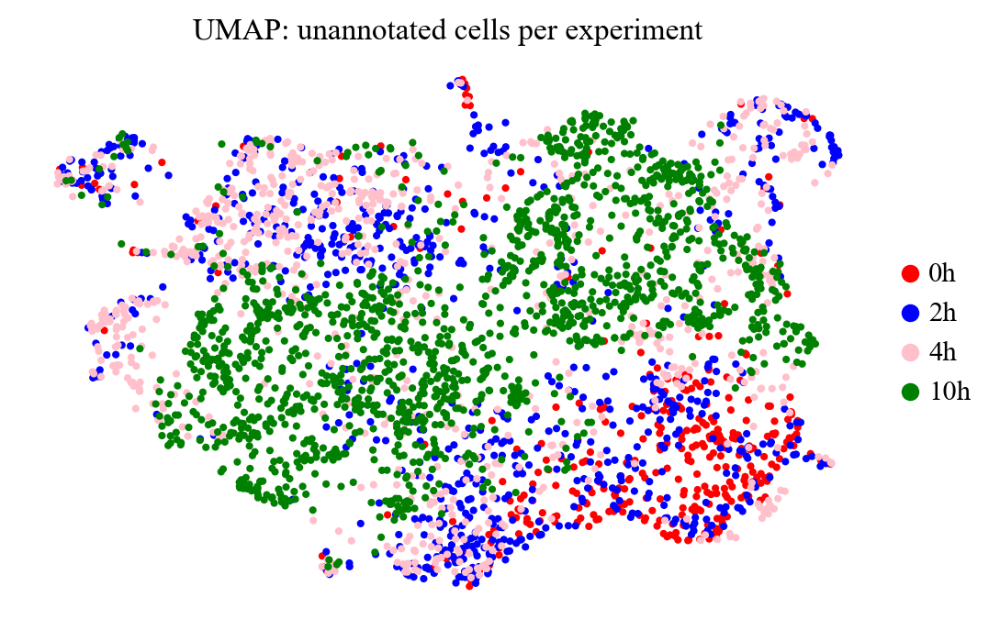

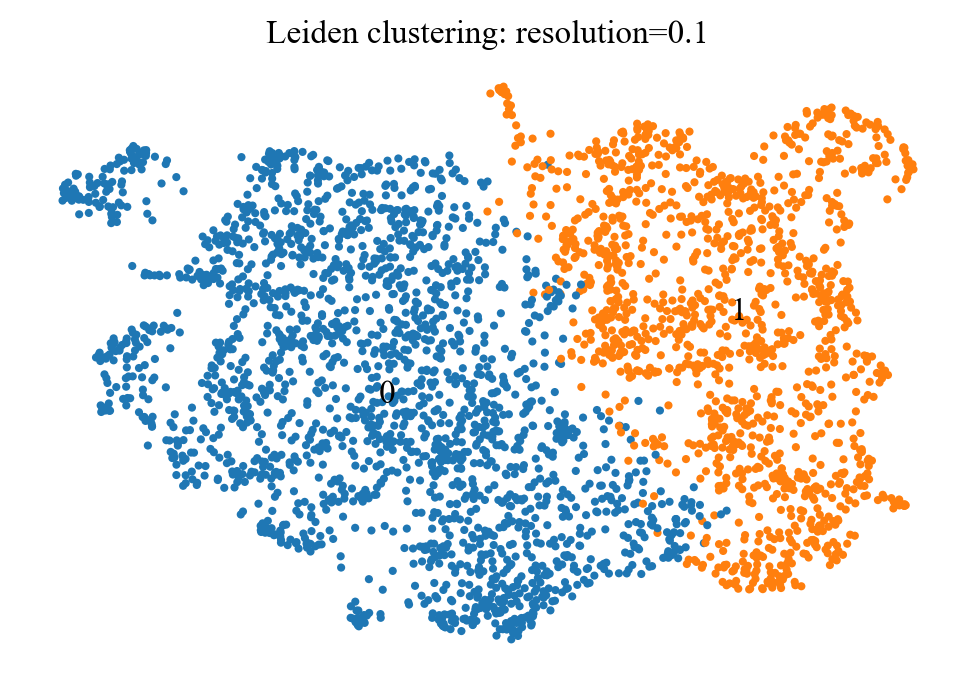

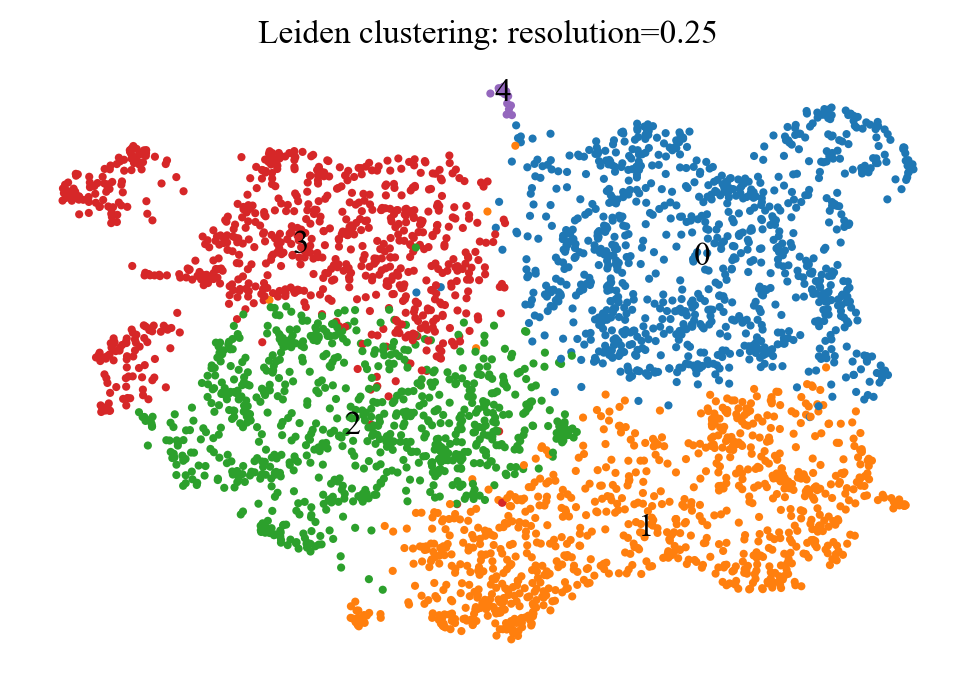

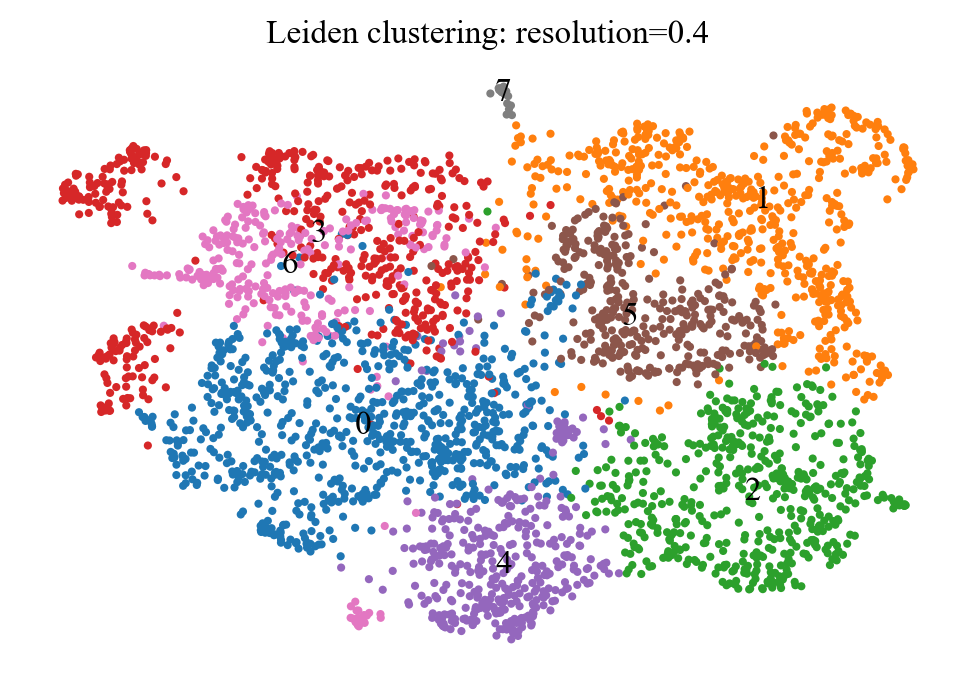

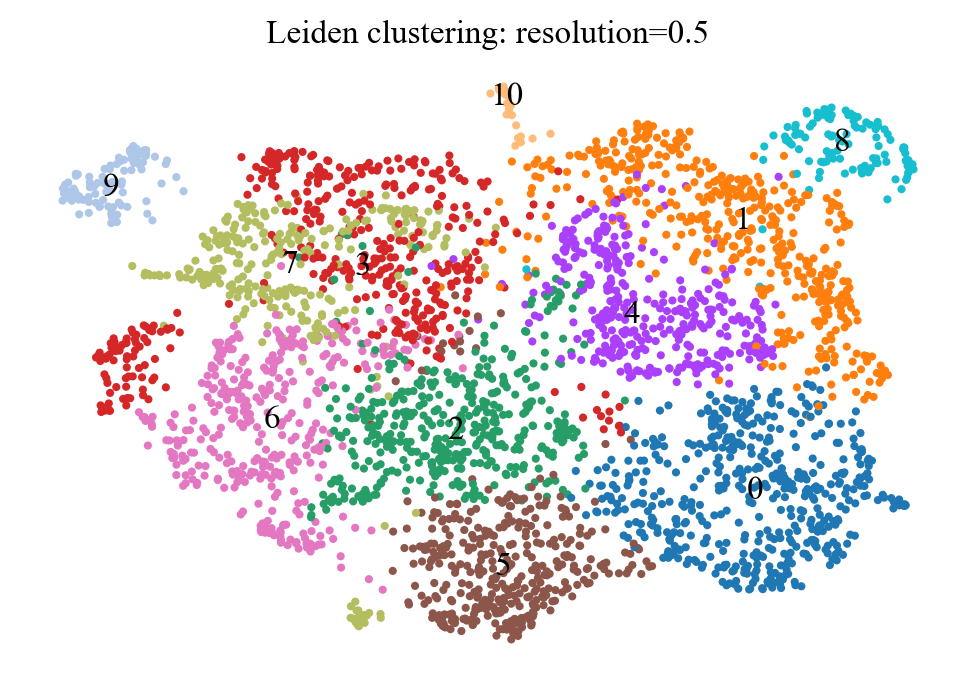

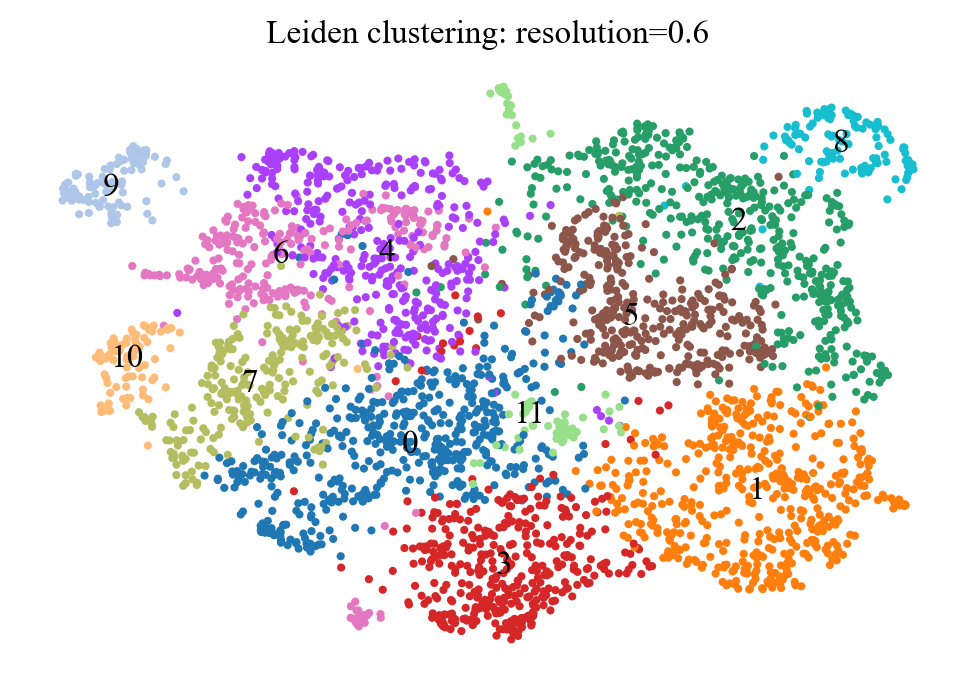

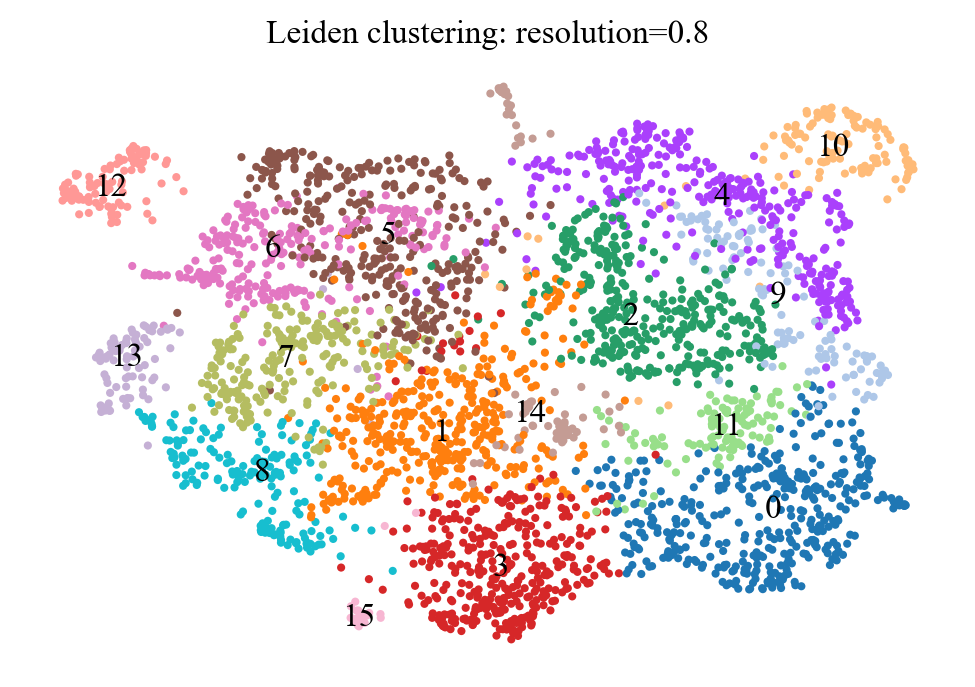

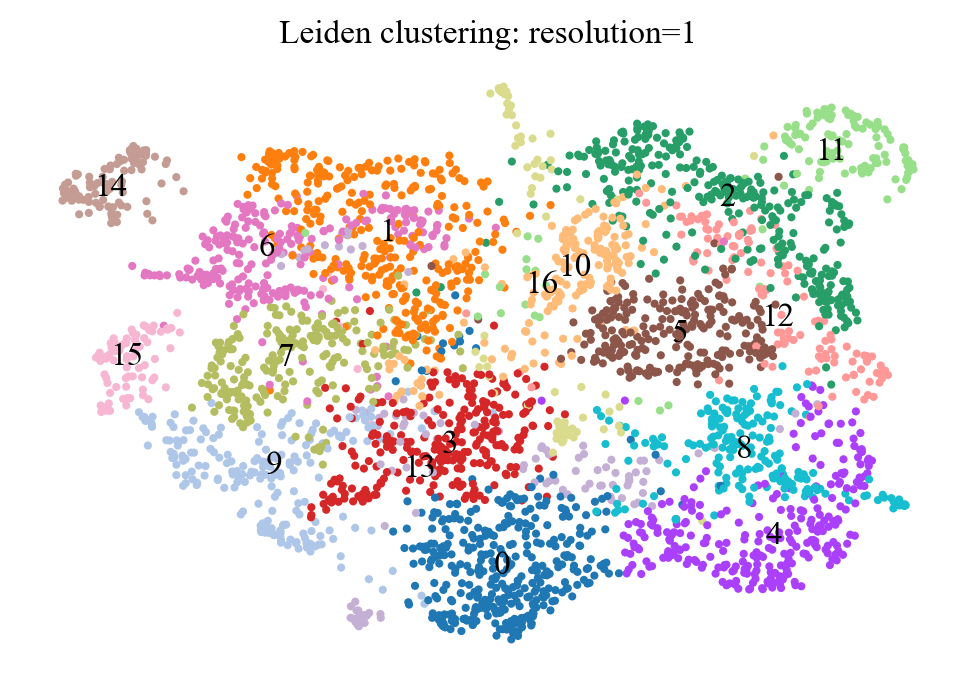

In [33]:
sc.pl.umap(unannotated_cells_07, color="experiment", palette=['red', 'blue', 'pink', 'green'], frameon=False, title="UMAP: unannotated cells per experiment")
sc.pl.umap(unannotated_cells_07, color=['leiden_res0_1'], legend_loc='on data', frameon=False, title="Leiden clustering: resolution=0.1")
sc.pl.umap(unannotated_cells_07, color=['leiden_res0_25'], legend_loc='on data', frameon=False, title="Leiden clustering: resolution=0.25")
sc.pl.umap(unannotated_cells_07, color=['leiden_res0_4'], legend_loc='on data', frameon=False, title="Leiden clustering: resolution=0.4")
sc.pl.umap(unannotated_cells_07, color=['leiden_res0_5'], legend_loc='on data', frameon=False, title="Leiden clustering: resolution=0.5")
sc.pl.umap(unannotated_cells_07, color=['leiden_res0_6'], legend_loc='on data', frameon=False, title="Leiden clustering: resolution=0.6")
sc.pl.umap(unannotated_cells_07, color=['leiden_res0_8'], legend_loc='on data', frameon=False, title="Leiden clustering: resolution=0.8")
sc.pl.umap(unannotated_cells_07, color=['leiden_res1'], legend_loc='on data', frameon=False, title="Leiden clustering: resolution=1")

**Explore expression of interesting genes**

In [34]:
new_df = pd.DataFrame({
    'Gene': ['KCS6', 'PDF1', 'BDG1', 'ATML1', 'EIR1', 'WOX7', 'SCR', 'HSFB4', 'JKD', 'PLT1', 'PLT2', 'WOX5', 'BHLH32', 'NPY4', 'MNP', 'AT3G52490', 'WOX11', 'LBD16', 'LBD18', 'LBD19', 'LBD29', 'JLO', 'NPH4', 'ARF19', 'RGF3', 'RGF8', 'PIP1A', 'AT4G37295', 'RAP2.4', 'AT1G22190', 'AT1G36060', 'PIN1', 'EIR1', 'PIN3', 'BBM', 'MP', 'LBD16', 'WOX5', 'KCS1', 'KCS6', 'KCS10', 'LP1', 'LTP2', 'HAG1', 'SDG2', 'HDA3', 'HD2B', 'HD2C', 'AT4G29100', 'RBP1', 'GRP7', 'DI21', 'KCS1', 'HWI1', 'BGL2', 'PUCHI', 'LAX3', 'AUX1', 'AT1G13030', 'IMP4', 'U2A\'', 'NOP10', 'U2B\'\'', 'smB', 'LKP2', 'U2B\'\'', 'AGO4', 'HYL1', 'AT1G49590', 'EMB2770', 'AT1G06960'],
    'Celltype': ['Outer cell layer', 'Outer cell layer', 'Outer cell layer', 'Outer cell layer', 'Outer cell layer', 'Middle cell layer', 'Middle cell layer', 'Middle cell layer', 'Middle cell layer', 'Middle cell layer', 'Middle cell layer', 'Middle cell layer', 'Inner cell layer', 'Inner cell layer', 'Inner cell layer', 'Inner cell layer', 'Callus founder', 'CIM-induced', 'Xylem differentiation', 'CIM-induced', 'CIM-induced', 'Xylem differentiation', 'LR formation', 'LR formation', 'Callus proliferation', 'Callus proliferation', 'Callus proliferation', 'Callus proliferation', 'CIM0', 'CIM0', 'CIM0', 'CIM0', 'CIM0', 'CIM0', 'CIM1', 'CIM1', 'CIM1', 'CIM1', 'CIM1', 'LRPI-like', 'LRPI-like', 'LRPI-like', 'LRPI-like', 'Epigenetics', 'Epigenetics', 'Epigenetics', 'Epigenetics', 'Epigenetics', 'Epigenetics', 'Epigenetics', 'Epigenetics', 'Epigenetics', 'VLCFA', 'VLCFA', 'VLCFA', 'VLCFA', 'Auxin transport', 'Auxin transport', 'Cajal bodies', 'Cajal bodies', 'Cajal bodies', 'Cajal bodies', 'Cajal bodies', 'Cajal bodies', 'Cajal bodies', 'Cajal bodies', 'Cajal bodies', 'Cajal bodies', 'Cajal bodies', 'Cajal bodies', 'Cajal bodies']
})

# Process cell types
new_df['Celltype'] = new_df['Celltype'].str.replace(r' \([^)]*\)', '', regex=True) # Remove any text in parentheses
new_df['Celltype'] = new_df['Celltype'].str.split('+')
new_df = new_df.explode('Celltype')
new_df['Celltype'] = new_df['Celltype'].str.strip()
celltype_dict = new_df.groupby('Celltype')['Gene'].apply(list).to_dict() # Create a dictionary with cell type as key and locus as values
print(celltype_dict)
markers={}
markers = {celltype: [gene for gene in genes if gene in adata_scanvi.raw.var["gene_symbol"].values] for celltype, genes in celltype_dict.items()}
print(markers)

{'Auxin transport': ['LAX3', 'AUX1'], 'CIM-induced': ['LBD16', 'LBD19', 'LBD29'], 'CIM0': ['RAP2.4', 'AT1G22190', 'AT1G36060', 'PIN1', 'EIR1', 'PIN3'], 'CIM1': ['BBM', 'MP', 'LBD16', 'WOX5', 'KCS1'], 'Cajal bodies': ['AT1G13030', 'IMP4', "U2A'", 'NOP10', "U2B''", 'smB', 'LKP2', "U2B''", 'AGO4', 'HYL1', 'AT1G49590', 'EMB2770', 'AT1G06960'], 'Callus founder': ['WOX11'], 'Callus proliferation': ['RGF3', 'RGF8', 'PIP1A', 'AT4G37295'], 'Epigenetics': ['HAG1', 'SDG2', 'HDA3', 'HD2B', 'HD2C', 'AT4G29100', 'RBP1', 'GRP7', 'DI21'], 'Inner cell layer': ['BHLH32', 'NPY4', 'MNP', 'AT3G52490'], 'LR formation': ['NPH4', 'ARF19'], 'LRPI-like': ['KCS6', 'KCS10', 'LP1', 'LTP2'], 'Middle cell layer': ['WOX7', 'SCR', 'HSFB4', 'JKD', 'PLT1', 'PLT2', 'WOX5'], 'Outer cell layer': ['KCS6', 'PDF1', 'BDG1', 'ATML1', 'EIR1'], 'VLCFA': ['KCS1', 'HWI1', 'BGL2', 'PUCHI'], 'Xylem differentiation': ['LBD18', 'JLO']}
{'Auxin transport': ['LAX3', 'AUX1'], 'CIM-induced': ['LBD16', 'LBD19', 'LBD29'], 'CIM0': ['RAP2.4', 

In [35]:
# Create a boolean mask to keep only annotated cells
filtered_mask_07 = adata_my_dataset.obs["final_annotation_celltype_0.7"] != "Unannotated"

# Create a new AnnData object with only annotated cells
adata_filtered_07 = adata_my_dataset[filtered_mask_07].copy()

# Check the dimensions of the new dataset
print(f"Original dataset shape: {adata_my_dataset.shape}")
print(f"Filtered dataset shape: {adata_filtered_07.shape}")

Original dataset shape: (68218, 5000)
Filtered dataset shape: (64730, 5000)


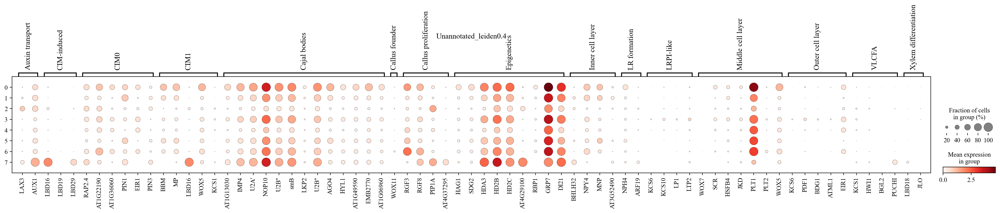

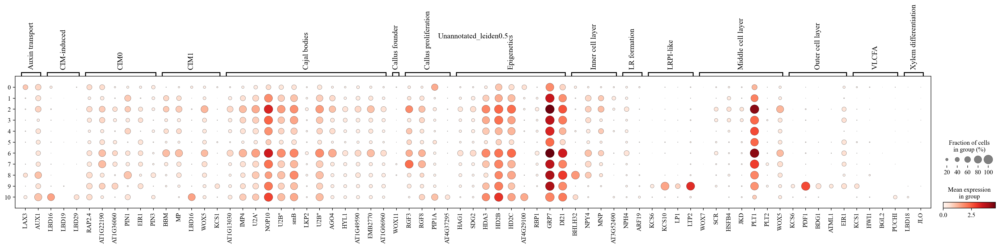

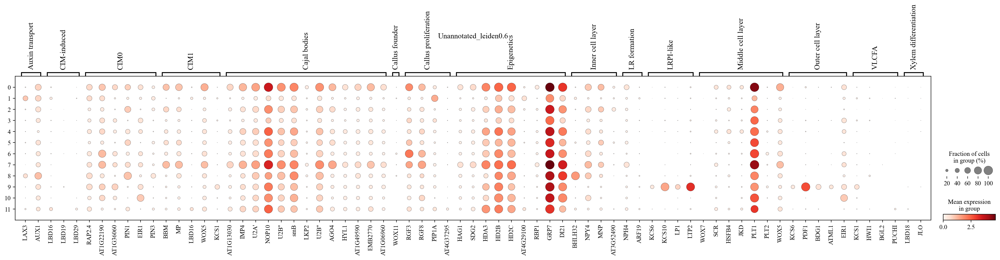

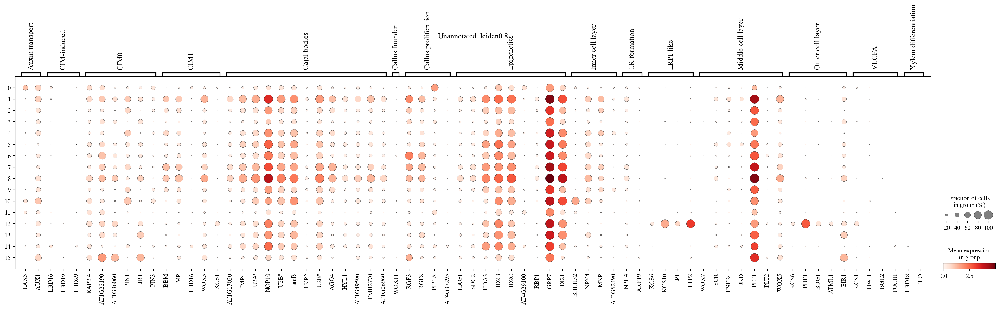

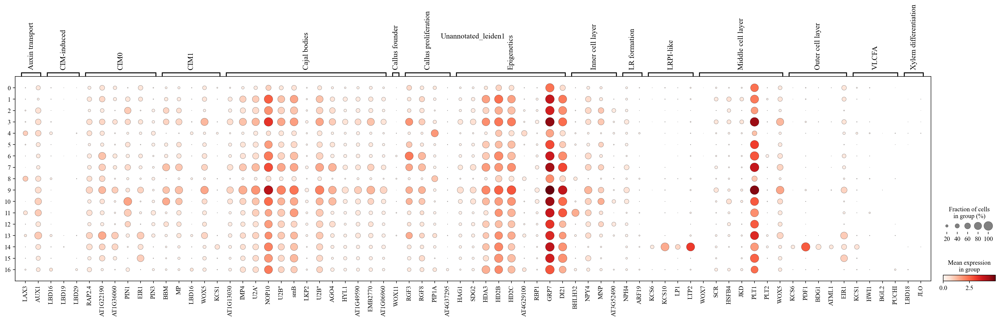

...

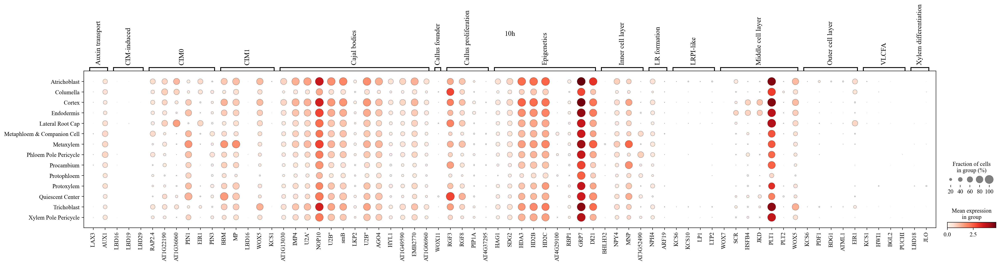

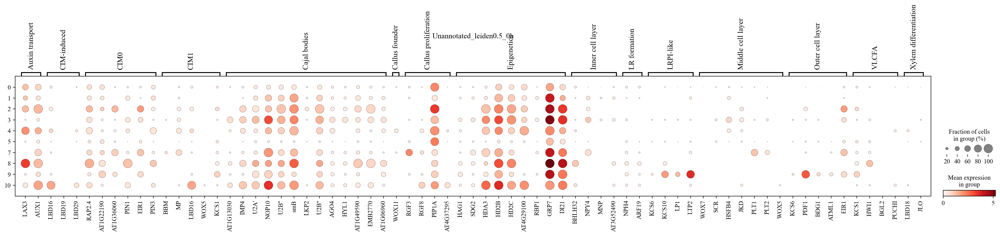

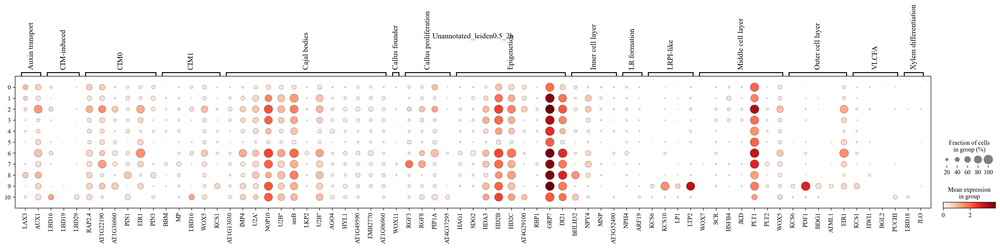

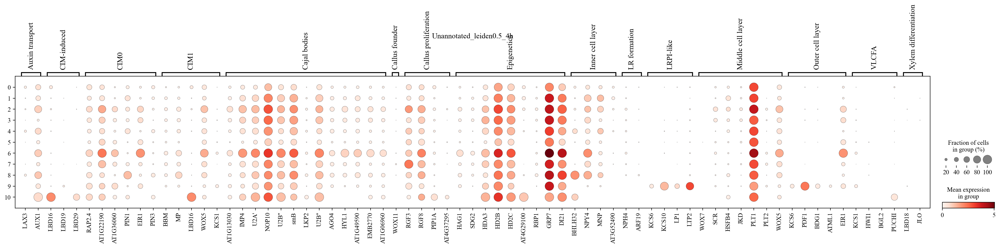

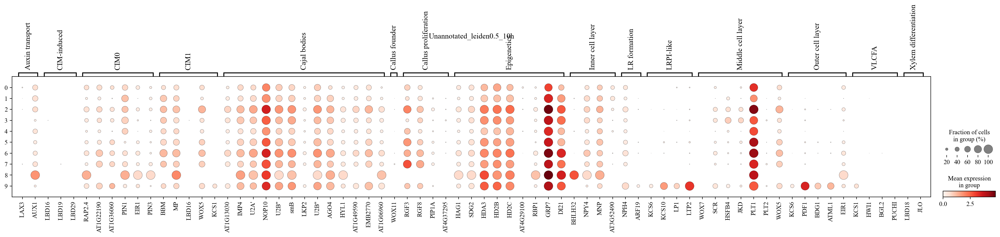

In [36]:
sc.pl.dotplot(unannotated_cells_07, markers, 'leiden_res0_4', gene_symbols="gene_symbol", log=True, title="Unannotated_leiden0.4")
sc.pl.dotplot(unannotated_cells_07, markers, 'leiden_res0_5', gene_symbols="gene_symbol", log=True, title="Unannotated_leiden0.5")
sc.pl.dotplot(unannotated_cells_07, markers, 'leiden_res0_6', gene_symbols="gene_symbol", log=True, title="Unannotated_leiden0.6")
sc.pl.dotplot(unannotated_cells_07, markers, 'leiden_res0_8', gene_symbols="gene_symbol", log=True, title="Unannotated_leiden0.8")
sc.pl.dotplot(unannotated_cells_07, markers, 'leiden_res1', gene_symbols="gene_symbol", log=True, title="Unannotated_leiden1")
sc.pl.dotplot(adata_filtered_07[adata_filtered_07.obs["experiment"] == "0h"], markers, 'final_annotation_celltype_0.7', gene_symbols="gene_symbol", log=True, title="0h")
sc.pl.dotplot(adata_filtered_07[adata_filtered_07.obs["experiment"] == "2h"], markers, 'final_annotation_celltype_0.7', gene_symbols="gene_symbol", log=True, title="2h")
sc.pl.dotplot(adata_filtered_07[adata_filtered_07.obs["experiment"] == "4h"], markers, 'final_annotation_celltype_0.7', gene_symbols="gene_symbol", log=True, title="4h")
sc.pl.dotplot(adata_filtered_07[adata_filtered_07.obs["experiment"] == "10h"], markers, 'final_annotation_celltype_0.7', gene_symbols="gene_symbol", log=True, title="10h")
sc.pl.dotplot(unannotated_cells_07[unannotated_cells_07.obs["experiment"] == "0h"], markers, 'leiden_res0_5', gene_symbols="gene_symbol", log=True, title="Unannotated_leiden0.5_0h")
sc.pl.dotplot(unannotated_cells_07[unannotated_cells_07.obs["experiment"] == "2h"], markers, 'leiden_res0_5', gene_symbols="gene_symbol", log=True, title="Unannotated_leiden0.5_2h")
sc.pl.dotplot(unannotated_cells_07[unannotated_cells_07.obs["experiment"] == "4h"], markers, 'leiden_res0_5', gene_symbols="gene_symbol", log=True, title="Unannotated_leiden0.5_4h")
sc.pl.dotplot(unannotated_cells_07[unannotated_cells_07.obs["experiment"] == "10h"], markers, 'leiden_res0_5', gene_symbols="gene_symbol", log=True, title="Unannotated_leiden0.5_10h")

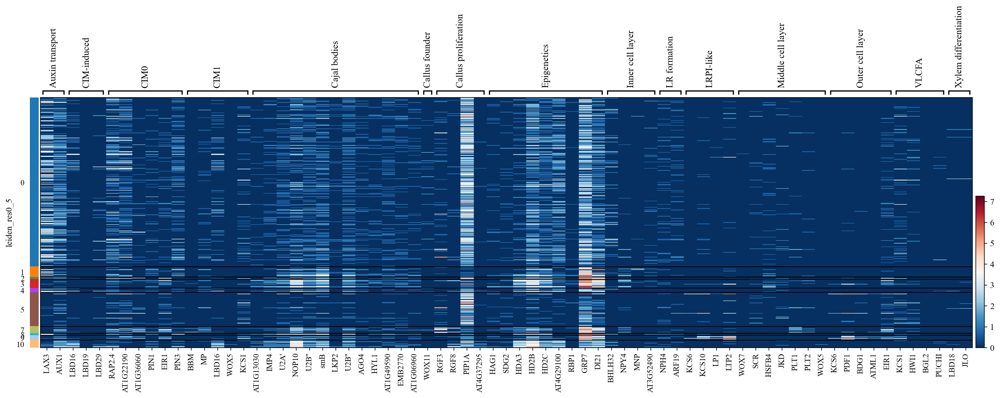

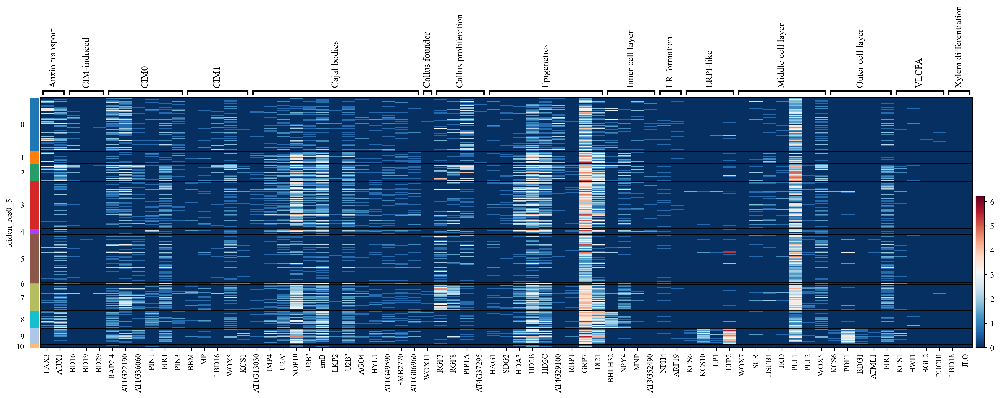

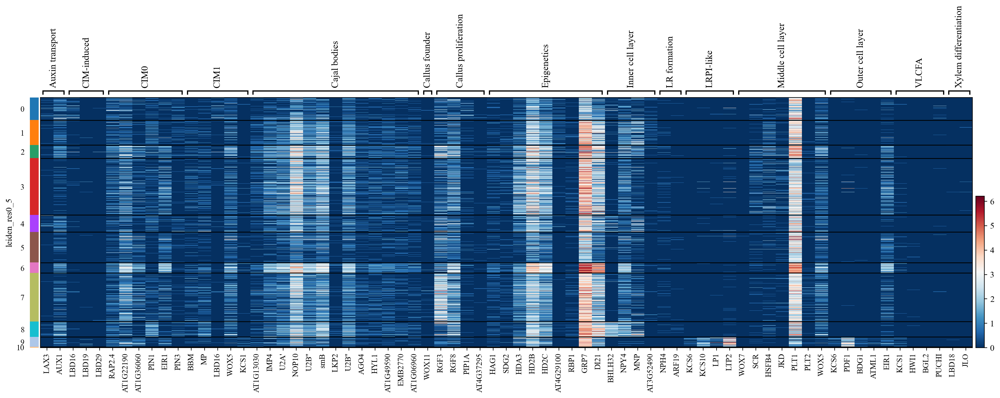

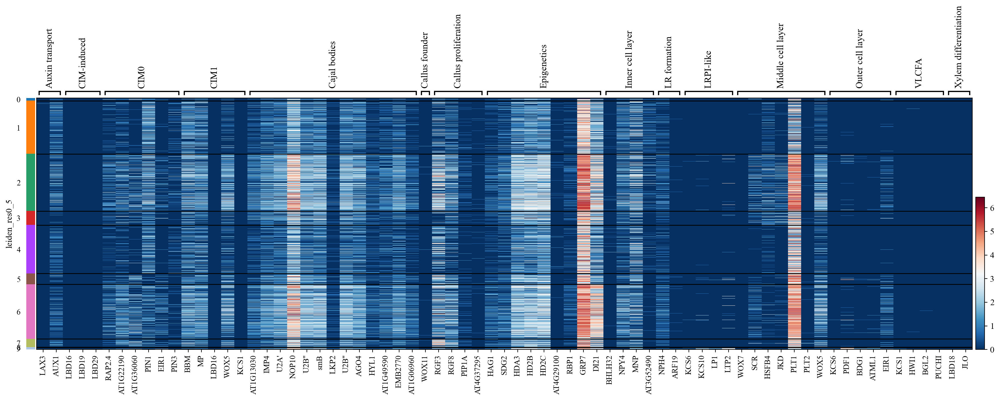

In [37]:
sc.pl.heatmap(unannotated_cells_07[unannotated_cells_07.obs["experiment"] == "0h"], markers, groupby='leiden_res0_5', gene_symbols="gene_symbol", swap_axes=False, show_gene_labels=True, log=True)
sc.pl.heatmap(unannotated_cells_07[unannotated_cells_07.obs["experiment"] == "2h"], markers, groupby='leiden_res0_5', gene_symbols="gene_symbol", swap_axes=False, show_gene_labels=True, log=True)
sc.pl.heatmap(unannotated_cells_07[unannotated_cells_07.obs["experiment"] == "4h"], markers, groupby='leiden_res0_5', gene_symbols="gene_symbol", swap_axes=False, show_gene_labels=True, log=True)
sc.pl.heatmap(unannotated_cells_07[unannotated_cells_07.obs["experiment"] == "10h"], markers, groupby='leiden_res0_5', gene_symbols="gene_symbol", swap_axes=False, show_gene_labels=True, log=True)

In [38]:
# Copy initial celltype annotations
unannotated_cells_07.obs['final_celltype'] = unannotated_cells_07.obs['final_annotation_celltype_0.7'].copy()

# Fill 'unannotated' cells with their clustering labels
unannotated_cells_07.obs.loc[unannotated_cells_07.obs["final_celltype"] == "Unannotated", "final_celltype"] = unannotated_cells_07.obs["leiden_res0_5"]

print(unannotated_cells_07.obs["final_celltype"].value_counts())

0     507
1     457
2     446
3     432
4     371
5     369
6     369
7     299
8     109
9     104
10     25
Name: final_celltype, dtype: int64


**Final percentage of cell type and developmental stage prediction**

First add Shahan et al. (2022) data

In [39]:
# Extract only "Shahan" cells from adata_scanvi
shahan_adata = adata_scanvi[adata_scanvi.obs["experiment"] == "Shahan"]

# Concatenate with final_anndata
adata_annotated_shahan = adata_scanvi.concatenate(shahan_adata, index_unique=None)

In [40]:
def prediction_percentage(adata, confidence_level, mode="celltype"):
    if mode == "celltype":
        annotation_col = f"final_annotation_celltype_{confidence_level}"
        y_label = "Cell type percentage"
        title = "Final cell type prediction"

    elif mode == "developmental":
        annotation_col = f"final_annotation_developmental_{confidence_level}"
        y_label = "Developmental stage percentage"
        title = "Final developmental stage prediction"

    else:
        raise ValueError("Invalid mode. Use 'celltype' or 'developmental'.")

    # Step 1: Count cells per sample and type
    cell_counts = adata.obs.groupby(["experiment", "sample", annotation_col]).size().reset_index(name="cell_count")

    # Step 2: Total cells per sample
    total_cells_per_sample = adata.obs.groupby("sample").size().reset_index(name="total_cells")

    # Step 3: Merge to get percentage
    cell_counts = cell_counts.merge(total_cells_per_sample, on="sample")

    # Step 4: Total cells per experiment
    total_cells_per_experiment = adata.obs.groupby("experiment").size().reset_index(name="experiment_total_cells")

    # Step 5: Sum cells per type per experiment
    cell_type_per_experiment = cell_counts.groupby(["experiment", annotation_col]).agg(
        total_cell_type_count=("cell_count", "sum")
    ).reset_index()

    # Step 6: Merge total counts
    cell_type_per_experiment = cell_type_per_experiment.merge(total_cells_per_experiment, on="experiment")

    # Step 7: Calculate percentage
    cell_type_per_experiment["percentage"] = (
        cell_type_per_experiment["total_cell_type_count"] / cell_type_per_experiment["experiment_total_cells"]
    ) * 100

    # Step 8: Plot
    pl.figure(figsize=(14, 8))
    sns.barplot(
        data=cell_type_per_experiment,
        x="experiment",
        y="percentage",
        hue=annotation_col,
        palette=general_palette
    )
    pl.xlabel("")
    pl.ylabel(y_label, fontsize=14)
    pl.tick_params(axis='both', labelsize=14)
    sns.despine(top=True, right=True)
    pl.legend(bbox_to_anchor=(1.05, 0.5), loc="center left", frameon=False, fontsize=12)
    pl.title(title, fontsize=18)
    pl.tight_layout()
    pl.show()

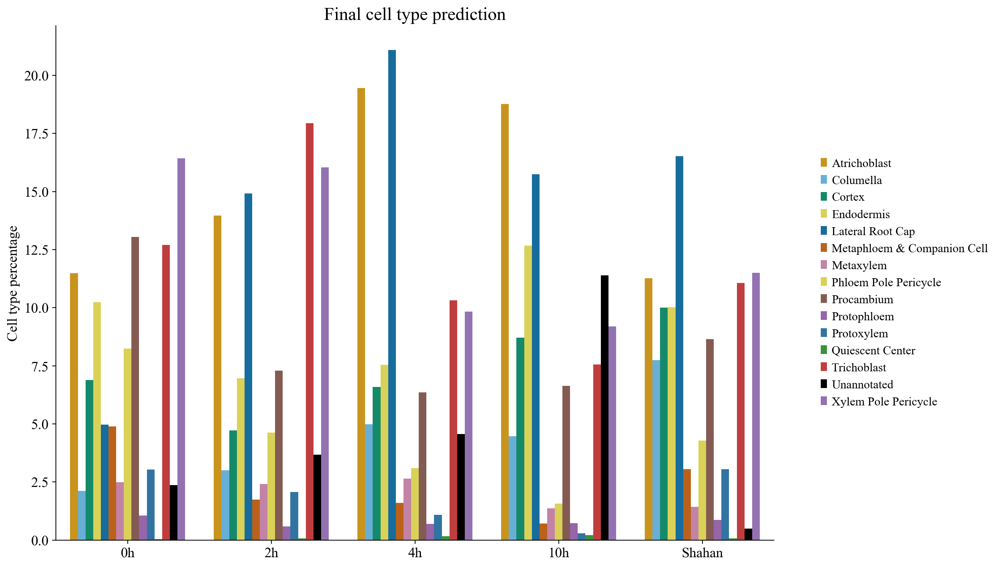

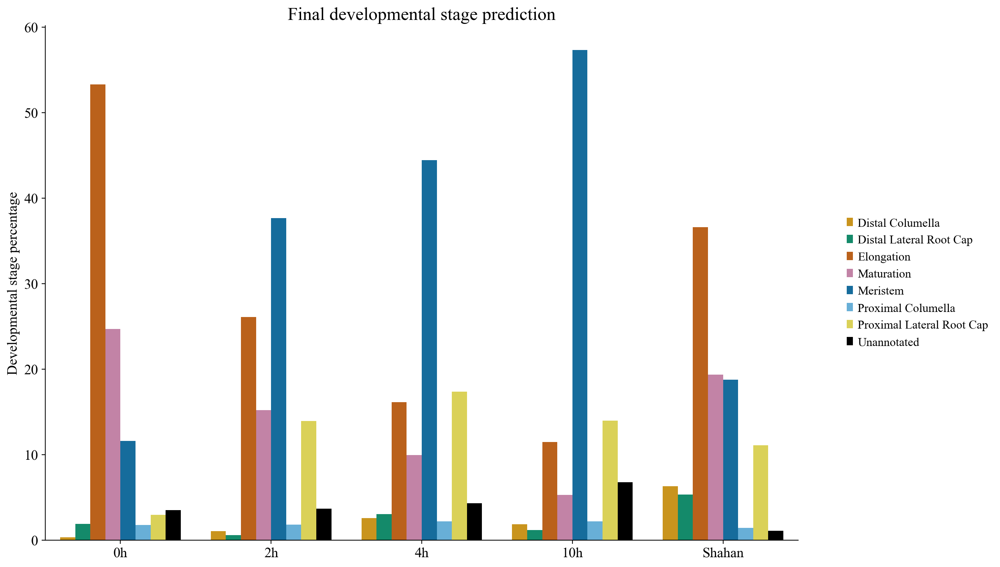

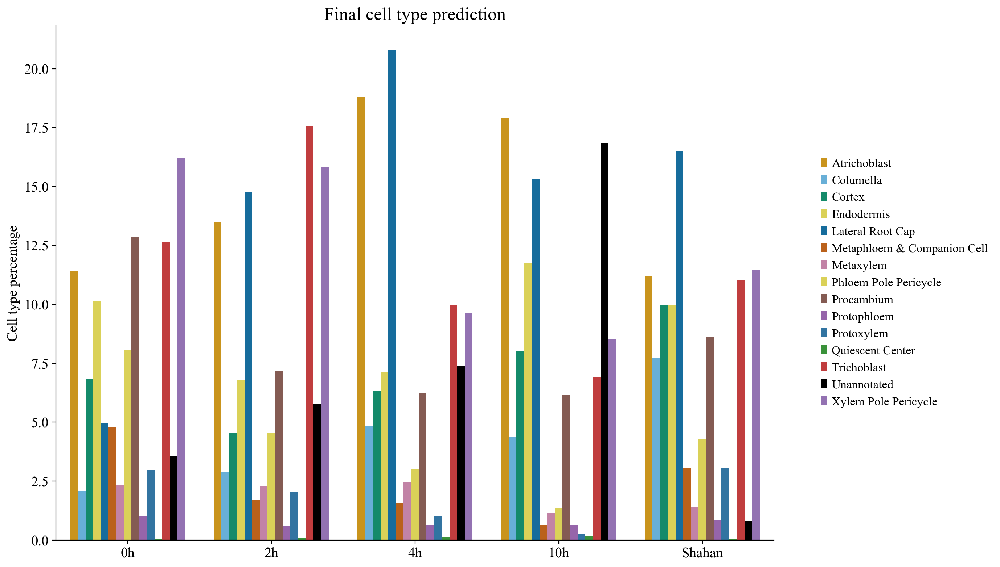

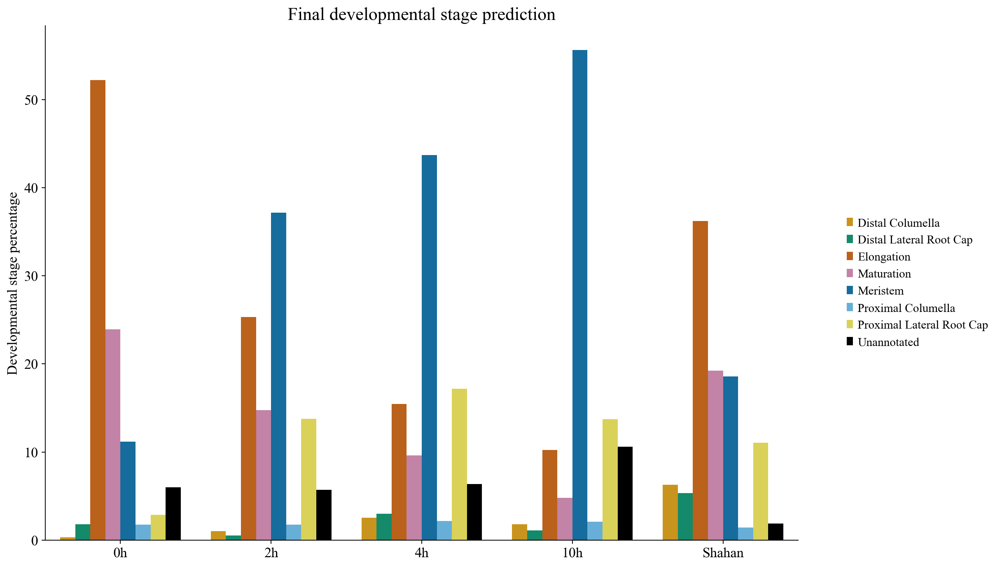

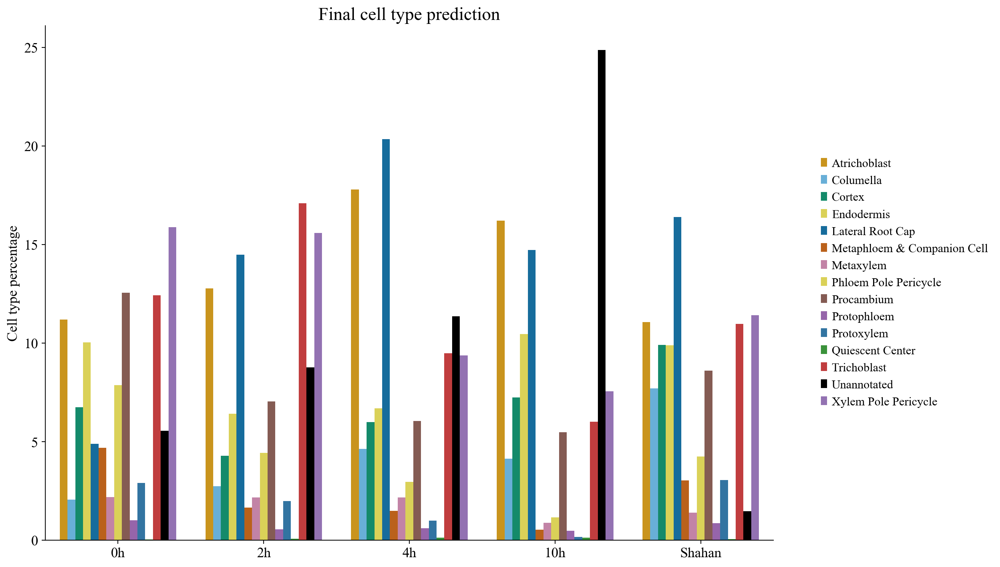

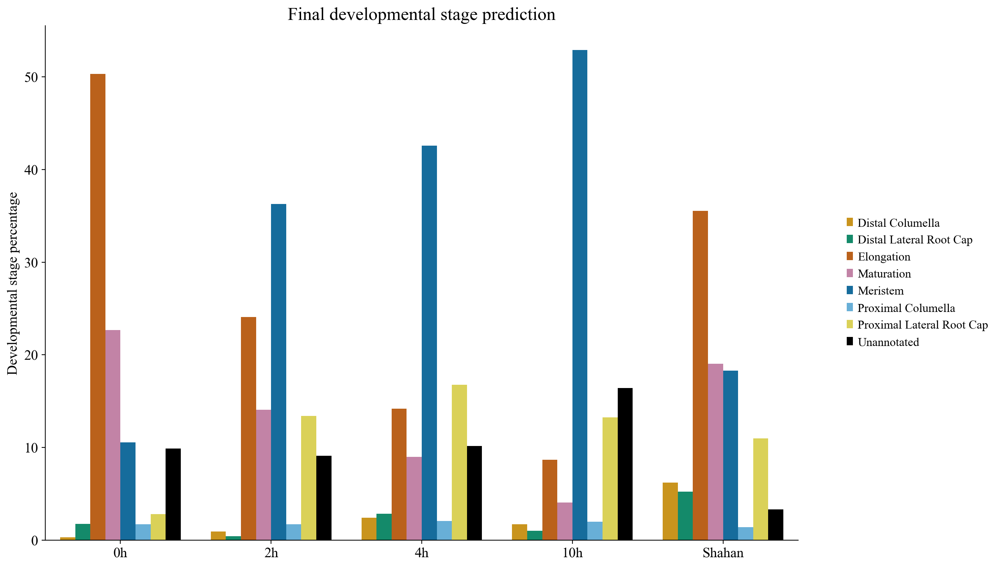

In [41]:
for confidence in [0.7, 0.8, 0.9]:
    prediction_percentage(adata_annotated_shahan, confidence, mode="celltype")
    prediction_percentage(adata_annotated_shahan, confidence, mode="developmental")

**Create the final Anndata object**

In [42]:
adata_my_final_dataset = adata_scanvi[adata_scanvi.obs['experiment'].isin(['0h', '2h', '4h', '10h'])].copy()

In [ ]:
adata_my_final_dataset.obs["final_clustering"] = unannotated_cells_07.obs["final_celltype"]
adata_my_final_dataset.obs["final_celltype"] = adata_my_final_dataset.obs["final_annotation_celltype_0.7"]

adata_my_final_dataset.obs.loc[adata_my_final_dataset.obs["final_clustering"] == "0", "final_celltype"] = "Unknown0"
adata_my_final_dataset.obs.loc[adata_my_final_dataset.obs["final_clustering"] == "1", "final_celltype"] = "Unknown1"
adata_my_final_dataset.obs.loc[adata_my_final_dataset.obs["final_clustering"] == "2", "final_celltype"] = "Unknown2"
adata_my_final_dataset.obs.loc[adata_my_final_dataset.obs["final_clustering"] == "3", "final_celltype"] = "Unknown3"
adata_my_final_dataset.obs.loc[adata_my_final_dataset.obs["final_clustering"] == "4", "final_celltype"] = "Unknown4"
adata_my_final_dataset.obs.loc[adata_my_final_dataset.obs["final_clustering"] == "5", "final_celltype"] = "Unknown5"
adata_my_final_dataset.obs.loc[adata_my_final_dataset.obs["final_clustering"] == "6", "final_celltype"] = "Unknown6"
adata_my_final_dataset.obs.loc[adata_my_final_dataset.obs["final_clustering"] == "7", "final_celltype"] = "Unknown7"
adata_my_final_dataset.obs.loc[adata_my_final_dataset.obs["final_clustering"] == "8", "final_celltype"] = "Unknown8"
adata_my_final_dataset.obs.loc[adata_my_final_dataset.obs["final_clustering"] == "9", "final_celltype"] = "Unknown9"
adata_my_final_dataset.obs.loc[adata_my_final_dataset.obs["final_clustering"] == "10", "final_celltype"] = "Unknown10"

print(adata_my_final_dataset.obs["final_celltype"].value_counts())

Atrichoblast                   10744
Lateral Root Cap                9840
Xylem Pole Pericycle            9004
Trichoblast                     8719
Endodermis                      6116
Procambium                      5604
Cortex                          4408
Phloem Pole Pericycle           3035
Columella                       2454
Metaxylem                       1556
Metaphloem & Companion Cell     1507
Protoxylem                      1149
Protophloem                      512
Unknown0                         507
Unknown1                         457
Unknown2                         446
Unknown3                         432
Unknown4                         371
Unknown5                         369
Unknown6                         369
Unknown7                         299
Unknown8                         109
Unknown9                         104
Quiescent Center                  82
Unknown10                         25
Name: final_celltype, dtype: int64


In [45]:
# Mask to keep cells where final_celltype is NOT "Unannotated" OR it starts with "Unknown"
mask_celltype = (adata_my_final_dataset.obs["final_celltype"] != "Unannotated")

# Apply the first mask
filtered_adata = adata_my_final_dataset[mask_celltype].copy()

# Now, remove "Unannotated" from developmental annotation, keeping "Unknown" cell types
mask_dev_stage = (
    (filtered_adata.obs["final_annotation_developmental_0.7"] != "Unannotated") |
    (filtered_adata.obs["final_celltype"].str.startswith("Unknown"))
)

# Apply the second mask
final_adata_annotated = filtered_adata[mask_dev_stage].copy()

# Print summary
print(final_adata_annotated.obs["final_celltype"].value_counts())
print(f"Original dataset shape: {adata_my_final_dataset.shape}")
print(f"Filtered dataset shape: {final_adata_annotated.shape}")


Atrichoblast                   10453
Lateral Root Cap                9525
Xylem Pole Pericycle            8418
Trichoblast                     8337
Endodermis                      5951
Procambium                      5330
Cortex                          4225
Phloem Pole Pericycle           2924
Columella                       2325
Metaxylem                       1499
Metaphloem & Companion Cell     1433
Protoxylem                      1092
Unknown0                         507
Protophloem                      488
Unknown1                         457
Unknown2                         446
Unknown3                         432
Unknown4                         371
Unknown5                         369
Unknown6                         369
Unknown7                         299
Unknown8                         109
Unknown9                         104
Quiescent Center                  68
Unknown10                         25
Name: final_celltype, dtype: int64
Original dataset shape: (68218, 5000)
Fi

In [46]:
# Create a boolean mask to keep only annotated cells
mask_adata_without_unannotated = adata_my_final_dataset.obs["final_celltype"] != "Unannotated"

# Create a new AnnData object with only annotated cells
final_adata_annotated = adata_my_final_dataset[mask_adata_without_unannotated].copy()

mask_adata_without_unannotated = final_adata_annotated.obs["final_annotation_developmental_0.7"] != "Unannotated"

final_adata_annotated = final_adata_annotated[mask_adata_without_unannotated].copy()

print(final_adata_annotated.obs["final_celltype"].value_counts())

# Check the dimensions of the new dataset
print(f"Original dataset shape: {adata_my_final_dataset.shape}")
print(f"Filtered dataset shape: {final_adata_annotated.shape}")

Atrichoblast                   10453
Lateral Root Cap                9525
Xylem Pole Pericycle            8418
Trichoblast                     8337
Endodermis                      5951
Procambium                      5330
Cortex                          4225
Phloem Pole Pericycle           2924
Columella                       2325
Metaxylem                       1499
Metaphloem & Companion Cell     1433
Protoxylem                      1092
Protophloem                      488
Unknown0                         464
Unknown1                         441
Unknown3                         428
Unknown2                         393
Unknown6                         342
Unknown4                         331
Unknown5                         315
Unknown7                         210
Unknown8                         108
Unknown9                          94
Quiescent Center                  68
Unknown10                         23
Name: final_celltype, dtype: int64
Original dataset shape: (68218, 5000)
Fi

In [47]:
print(final_adata_annotated)
print(final_adata_annotated.obs["experiment"].unique())
print(final_adata_annotated.obs["final_celltype"].unique())
print(final_adata_annotated.obs["final_annotation_developmental_0.7"].unique())

AnnData object with n_obs × n_vars = 65217 × 5000
    obs: 'sample', 'batch', 'experiment', 'shahan_celltype', 'shahan_developmental', '_scvi_batch', '_scvi_labels', 'final_annotation_celltype_0.7', 'final_annotation_celltype_0.8', 'final_annotation_celltype_0.9', 'unannotated_2_likely', 'unannotated_2_likely_merged', 'lineage_low_confidence', 'final_lineages', '_prediction', 'final_annotation_developmental_0.7', 'final_annotation_developmental_0.8', 'final_annotation_developmental_0.9', 'final_clustering', 'final_celltype'
    var: 'gene_symbol', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'experiment_colors', 'hvg', 'neighbors', 'shahan_celltype_colors', 'shahan_developmental_colors', 'umap'
    obsm: 'X_scVI', 'X_umap', 'X_scANVI', 'C_scANVI'
    layers: 'scVI'
    obsp: 'connectivities', 'distances'
['0h', '2h', '4h', '10h']
Categories (4, object): ['0h', '2h', '4h', '10h'

In [48]:
# Create a summary table
summary_table = final_adata_annotated.obs.groupby(["final_celltype", "final_annotation_developmental_0.7", "experiment"]).size().unstack()

with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    display(summary_table)

experiment                                                        0h    2h  \
final_celltype              final_annotation_developmental_0.7               
Atrichoblast                Distal Columella                       0     0   
                            Distal Lateral Root Cap                0     0   
                            Elongation                           702   321   
                            Maturation                           505   163   
                            Meristem                             511  2537   
                            Proximal Columella                     0     0   
                            Proximal Lateral Root Cap              0     0   
Columella                   Distal Columella                      47   232   
                            Distal Lateral Root Cap                0     0   
                            Elongation                             0     0   
                            Maturation                             0     0   
                            Meristem                               0     0   
                            Proximal Columella                   269   403   
                            Proximal Lateral Root Cap              0     0   
Cortex                      Distal Columella                       0     0   
                            Distal Lateral Root Cap                0     0   
                            Elongation                           650   206   
                            Maturation                           238   122   
                            Meristem                             135   676   
                            Proximal Columella                     0     0   
                            Proximal Lateral Root Cap              0     0   
Endodermis                  Distal Columella                       0     0   
                            Distal Lateral Root Cap                0     0   
                            Elongation                           779   662   
                            Maturation                           667   246   
                            Meristem                             105   615   
                            Proximal Columella                     0     0   
                            Proximal Lateral Root Cap              0     0   
Lateral Root Cap            Distal Columella                       0     0   
                            Distal Lateral Root Cap              286   126   
                            Elongation                             0     0   
                            Maturation                             0     0   
                            Meristem                               0     0   
                            Proximal Columella                     0     0   
                            Proximal Lateral Root Cap            449  3084   
Metaphloem & Companion Cell Distal Columella                       0     0   
                            Distal Lateral Root Cap                0     0   
                            Elongation                           516   165   
                            Maturation                           152    84   
                            Meristem                              48   116   
                            Proximal Columella                     0     0   
                            Proximal Lateral Root Cap              0     0   
Metaxylem                   Distal Columella                       0     0   
                            Distal Lateral Root Cap                0     0   
                            Elongation                           347   367   
                            Maturation                             1     2   
                            Meristem                              25   146   
                            Proximal Columella                     0     0   
                            Proximal Lateral Root Cap              0     0   
Phloem Pole Pericycle 

**Percentage unknown subpopulations across time**

In [49]:
print(final_adata_annotated.obs["final_celltype"].value_counts())
# Create a boolean mask to keep only categories starting with "Unknown"
mask_unknown = final_adata_annotated.obs["final_celltype"].str.startswith("Unknown")

# Filter dataset to keep only "Unknown*" categories
final_adata_unknown = final_adata_annotated[mask_unknown].copy()

# Print cell counts for each "Unknown*" category
print(final_adata_unknown.obs["final_celltype"].value_counts())

# Check dataset dimensions
print(f"Original dataset shape: {final_adata_annotated.shape}")
print(f"Filtered dataset shape: {final_adata_unknown.shape}")

Atrichoblast                   10453
Lateral Root Cap                9525
Xylem Pole Pericycle            8418
Trichoblast                     8337
Endodermis                      5951
Procambium                      5330
Cortex                          4225
Phloem Pole Pericycle           2924
Columella                       2325
Metaxylem                       1499
Metaphloem & Companion Cell     1433
Protoxylem                      1092
Protophloem                      488
Unknown0                         464
Unknown1                         441
Unknown3                         428
Unknown2                         393
Unknown6                         342
Unknown4                         331
Unknown5                         315
Unknown7                         210
Unknown8                         108
Unknown9                          94
Quiescent Center                  68
Unknown10                         23
Name: final_celltype, dtype: int64
Unknown0     464
Unknown1     441
Unknow

In [51]:
custom_order = ['Unknown0', 'Unknown1', 'Unknown2', 'Unknown3', 'Unknown4', 'Unknown5', 'Unknown6', 'Unknown7', 'Unknown8', 'Unknown9', 'Unknown10']

# Ensure 'experiment' is a categorical variable
final_adata_unknown.obs["final_celltype"] = final_adata_unknown.obs["final_celltype"].astype("category")

# Reorder the categories based on the custom order
final_adata_unknown.obs["final_celltype"].cat.reorder_categories(custom_order, inplace=True)

In [53]:
unknown_palette = {
    "Unknown0": "#A9A9A9",     # Dark Gray (Lighter than Procambium)
    "Unknown1": "#FFFF33",     # Bright Yellow
    "Unknown2": "#4daf4a",     # Forest Green
    "Unknown3": "#F781BF",     # Light Pink
    "Unknown4": "#000000",     # Black (As requested)
    "Unknown5": "#800080",     # Purple
    "Unknown6": "#FF8C00",     # Dark Orange
    "Unknown7": "#404040",     # Darker Grey
    "Unknown8": "#808000",     # Olive
    "Unknown9": "#FF00FF",     # Magenta
    "Unknown10": "#BDB76B",    # Khaki
    "Unknown11": "#2F4F4F"     # Dark Slate Grey
}

In [ ]:
# Define the function to process data and generate plots
def process_and_plot(confidence_level):
    # Step 1: Count the number of cells for each sample and each cell type
    cell_counts = final_adata_unknown.obs.groupby(["experiment", "sample", "final_celltype"]).size().reset_index(name="cell_count")

    # Step 2: Count the total number of cells per sample
    total_cells_per_sample = final_adata_unknown.obs.groupby("sample").size().reset_index(name="total_cells")

    # Step 3: Merge the two DataFrames to calculate the percentage of each cell type in each sample
    cell_counts = cell_counts.merge(total_cells_per_sample, on="sample")

    # Step 4: Sum the total number of cells across all samples in each experiment
    total_cells_per_experiment = final_adata_unknown.obs.groupby("experiment").size().reset_index(name="experiment_total_cells")

    # Step 5: Sum the number of cells of each cell type across all samples in each experiment
    cell_type_per_experiment = cell_counts.groupby(["experiment", "final_celltype"]).agg(
        total_cell_type_count=("cell_count", "sum")
    ).reset_index()

    # Step 6: Merge the total cell counts per experiment with the summed cell type counts
    cell_type_per_experiment = cell_type_per_experiment.merge(total_cells_per_experiment, on="experiment")

    # Step 7: Calculate the percentage of each cell type in the experiment
    cell_type_per_experiment["percentage"] = (cell_type_per_experiment["total_cell_type_count"] /
                                               cell_type_per_experiment["experiment_total_cells"]) * 100

    # Step 8: Plot the average percentage of each cell type in each experiment
    pl.figure(figsize=(14, 8))
    sns.barplot(data=cell_type_per_experiment, x="experiment", y="percentage", hue="final_celltype", palette=custom_palette_celltype)

    # Customize the plot
    pl.xticks(rotation=45, ha="right")  # Rotate x-axis labels for readability
    pl.xlabel("Experiment")
    pl.ylabel("Percentage of Cells")
    pl.title(f"{confidence_level} confidence")

    # Adjust the legend position and remove the box around it
    pl.legend(bbox_to_anchor=(1.05, 0.5), loc="center left", frameon=False)

    pl.tight_layout()
    pl.show()

# Run the function for each confidence level
for confidence in [0.7]:
    process_and_plot(confidence)


In [61]:
def prediction_percentage(adata, confidence_level=0.7, mode="celltype"):
    if mode == "celltype":
        annotation_col = f"final_annotation_celltype_{confidence_level}"
        y_label = "Cell type percentage"
        title = "Final cell type prediction"
    elif mode == "developmental":
        annotation_col = f"final_annotation_developmental_{confidence_level}"
        y_label = "Developmental stage percentage"
        title = "Final developmental stage prediction"
    elif mode == "unknown":
        annotation_col = "final_celltype"
        y_label = "Unknown subpopulations percentage"
        title = "Unknown subpopulations across time"
        general_palette = unknown_palette
    else:
        raise ValueError("Invalid mode. Use 'celltype', 'developmental', or 'unknown'.")

    # Step 1: Count cells per sample and type
    cell_counts = adata.obs.groupby(["experiment", "sample", annotation_col]).size().reset_index(name="cell_count")

    # Step 2: Total cells per sample
    total_cells_per_sample = adata.obs.groupby("sample").size().reset_index(name="total_cells")

    # Step 3: Merge to get percentage
    cell_counts = cell_counts.merge(total_cells_per_sample, on="sample")

    # Step 4: Total cells per experiment
    total_cells_per_experiment = adata.obs.groupby("experiment").size().reset_index(name="experiment_total_cells")

    # Step 5: Sum cells per type per experiment
    cell_type_per_experiment = cell_counts.groupby(["experiment", annotation_col]).agg(
        total_cell_type_count=("cell_count", "sum")
    ).reset_index()

    # Step 6: Merge total counts
    cell_type_per_experiment = cell_type_per_experiment.merge(total_cells_per_experiment, on="experiment")

    # Step 7: Calculate percentage
    cell_type_per_experiment["percentage"] = (
        cell_type_per_experiment["total_cell_type_count"] / cell_type_per_experiment["experiment_total_cells"]
    ) * 100

    # ✅ Step 7.5: Filter only the types starting with "Unknown" (for plotting)
    filtered_data = cell_type_per_experiment[
        cell_type_per_experiment[annotation_col].str.startswith("Unknown")
    ]

    # Step 8: Plot
    pl.figure(figsize=(14, 8))
    sns.barplot(
        data=filtered_data,
        x="experiment",
        y="percentage",
        hue=annotation_col,
        palette=general_palette
    )
    pl.xlabel("")
    pl.ylabel(y_label, fontsize=14)
    pl.tick_params(axis='both', labelsize=14)
    sns.despine(top=True, right=True)
    pl.legend(bbox_to_anchor=(1.05, 0.5), loc="center left", frameon=False, fontsize=12)
    pl.title(title, fontsize=18)
    pl.tight_layout()
    pl.show()


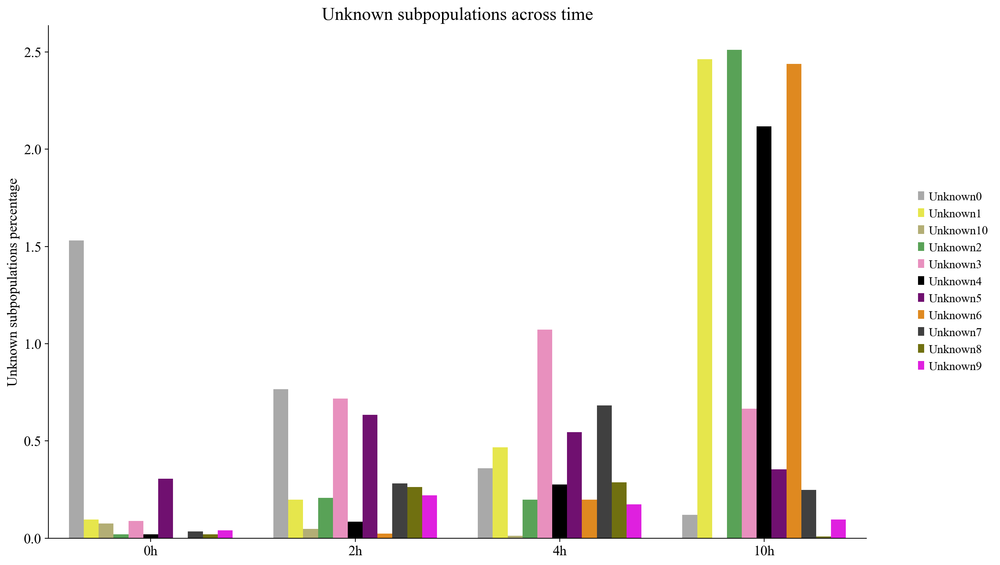

In [62]:
prediction_percentage(final_adata_annotated, mode="unknown")

In [63]:
final_adata_annotated.obs["final_annotation_developmental_0.7"] = final_adata_annotated.obs["final_annotation_developmental_0.7"].astype("str")

final_adata_annotated.obs.loc[
    final_adata_annotated.obs["final_annotation_celltype_0.7"] == "Unannotated", 
    "final_annotation_developmental_0.7"
] = ""

print(len(final_adata_annotated.obs["final_annotation_developmental_0.7"]))
print(final_adata_annotated.obs["final_annotation_developmental_0.7"].value_counts())

65217
Meristem                     23039
Elongation                   17808
Maturation                    9371
Proximal Lateral Root Cap     8425
                              3149
Proximal Columella            1347
Distal Lateral Root Cap       1100
Distal Columella               978
Name: final_annotation_developmental_0.7, dtype: int64


In [64]:
# Remove spaces and concatenate the columns
final_adata_annotated.obs["final_annotation_MINI-EX"] = (
    final_adata_annotated.obs["final_celltype"].astype(str).str.replace(" ", "", regex=True).str.strip() + 
    final_adata_annotated.obs["final_annotation_developmental_0.7"].astype(str).str.replace(" ", "", regex=True).str.strip()
)

# Print unique values to verify
print(len(final_adata_annotated.obs["final_annotation_MINI-EX"]))
print(final_adata_annotated.obs["final_annotation_MINI-EX"].value_counts())


65217
LateralRootCapProximalLateralRootCap    8425
AtrichoblastMeristem                    8015
TrichoblastMeristem                     5355
ProcambiumElongation                    3644
XylemPolePericycleElongation            3590
XylemPolePericycleMaturation            2985
EndodermisMeristem                      2763
CortexMeristem                          2489
EndodermisElongation                    2153
XylemPolePericycleMeristem              1843
PhloemPolePericycleElongation           1671
TrichoblastElongation                   1633
AtrichoblastElongation                  1416
TrichoblastMaturation                   1349
ColumellaProximalColumella              1347
CortexElongation                        1165
LateralRootCapDistalLateralRootCap      1100
EndodermisMaturation                    1035
AtrichoblastMaturation                  1022
ColumellaDistalColumella                 978
PhloemPolePericycleMaturation            952
MetaxylemElongation                      939
Proc

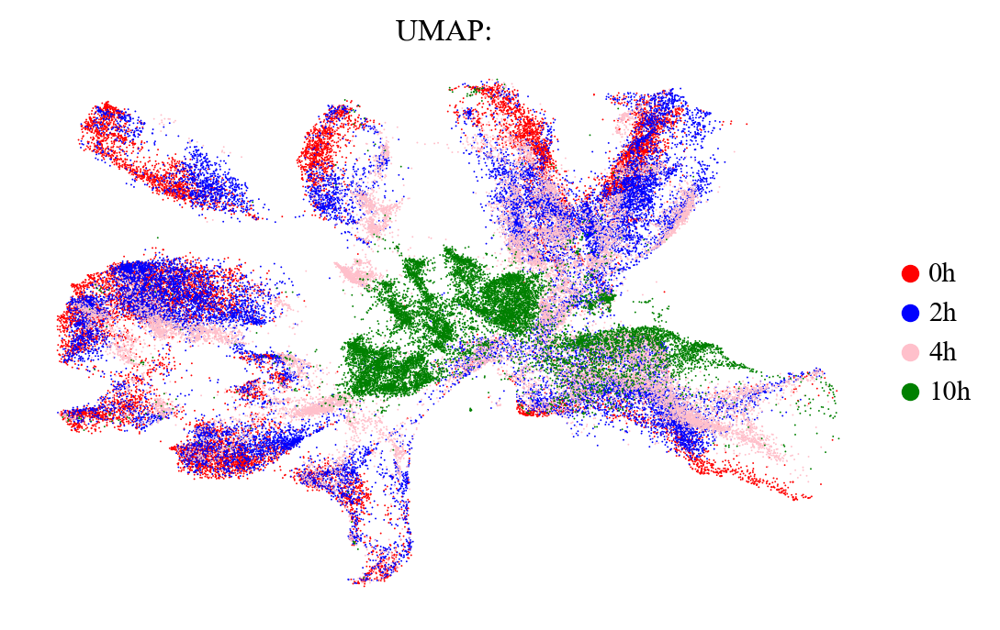

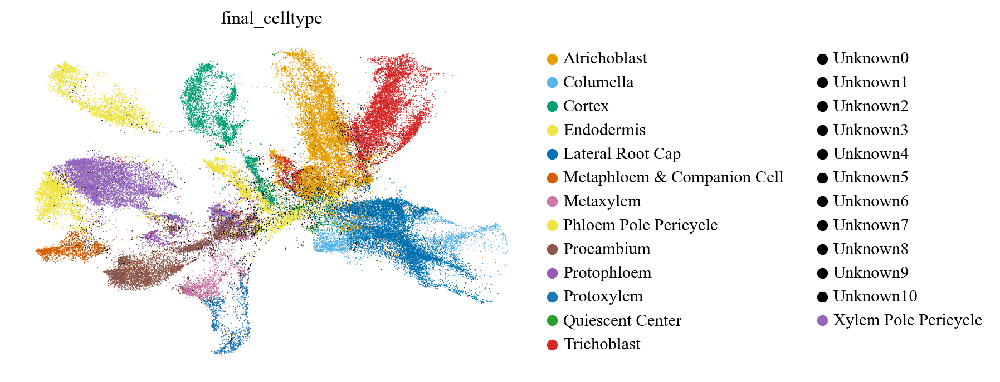

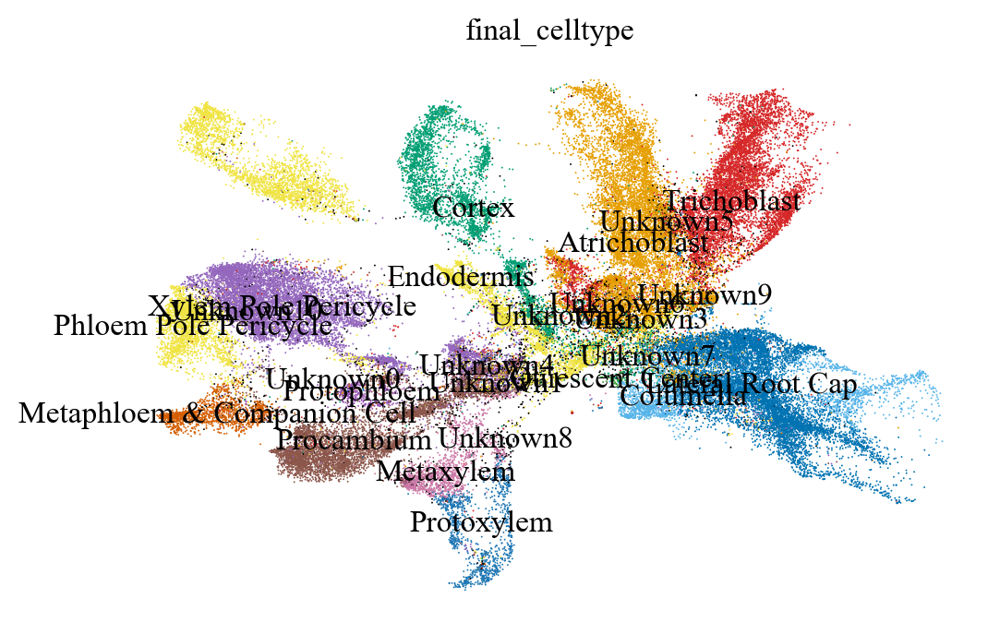

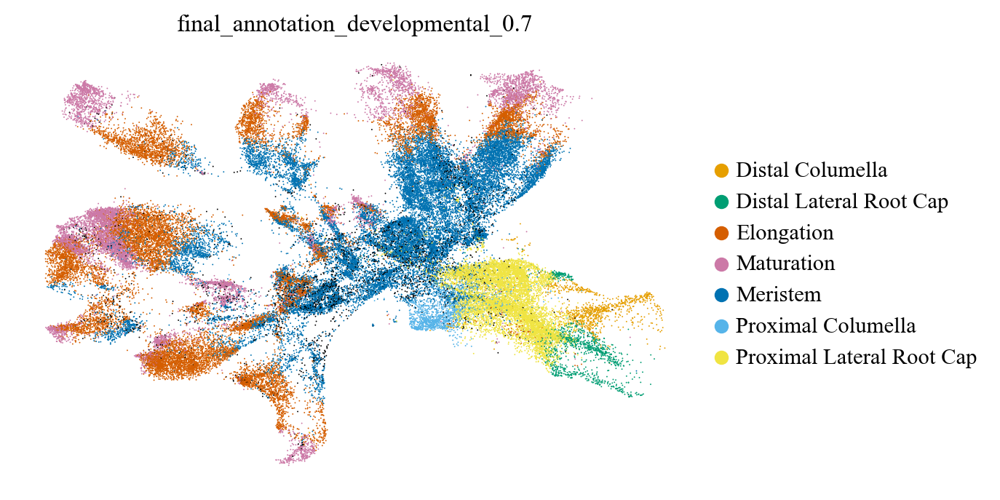

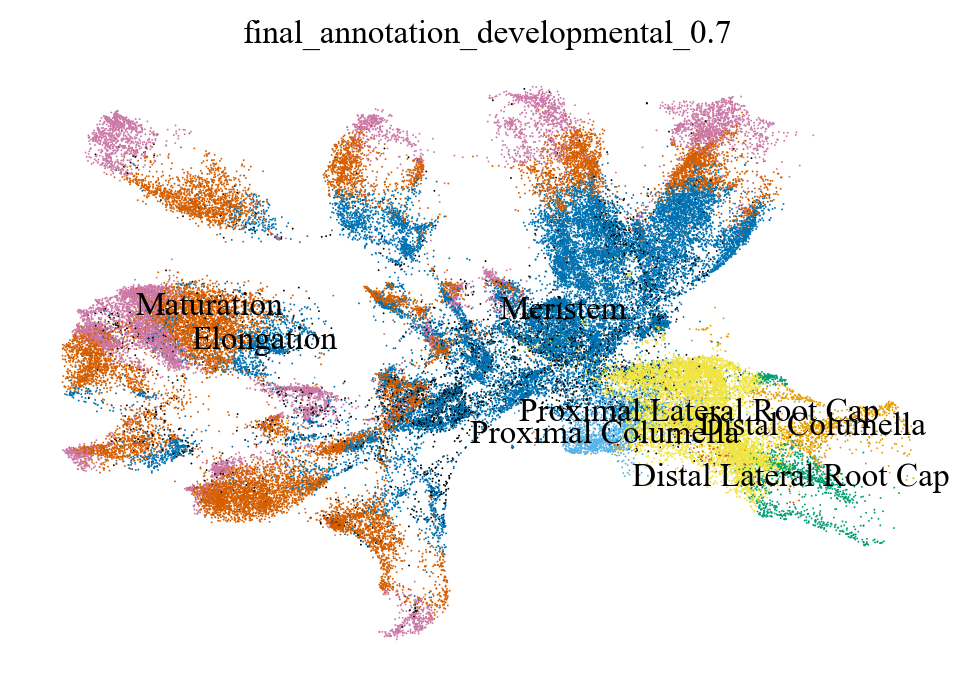

In [65]:
custom_palette_celltype = {
    "Atrichoblast": "#E69F00", 
    "Columella": "#56B4E9", 
    "Cortex": "#009E73", 
    "Endodermis": "#F0E442", 
    "Lateral Root Cap": "#0072B2",
    "Metaphloem & Companion Cell": "#D55E00", 
    "Metaxylem": "#CC79A7", 
    "Phloem Pole Pericycle": "#F0E442", 
    "Procambium": "#8C564B", 
    "Protophloem": "#9B59B6", 
    "Protoxylem": "#1F77B4", 
    "Quiescent Center": "#2CA02C",
    "Trichoblast": "#D62728", 
    "Xylem Pole Pericycle": "#9467BD",
    #"Unknown0": "blue",
    #"Unknown1": "yellow", 
    #"Unknown2": "green",
    #"Unknown3": "pink",
    #"Unknown4": "red",
    #"Unknown5": "purple",
    #"Unknown6": "orange",
    #"Unknown7": "black",
    #"Unknown8": "olive",
    #"Unknown9": "magenta",
    #"Unknown10": "khaki",
    #"Unknown11": "darkslategrey"
    "Unknown0": "black",
    "Unknown1": "black", 
    "Unknown2": "black",
    "Unknown3": "black",
    "Unknown4": "black",
    "Unknown5": "black",
    "Unknown6": "black",
    "Unknown7": "black",
    "Unknown8": "black",
    "Unknown9": "black",
    "Unknown10": "black",
    "Unknown11": "black"
}

custom_palette_developmental = {
    "Distal Columella": "#E69F00", 
    "Proximal Columella": "#56B4E9", 
    "Distal Lateral Root Cap": "#009E73", 
    "Proximal Lateral Root Cap": "#F0E442", 
    "Meristem": "#0072B2", 
    "Elongation": "#D55E00", 
    "Maturation": "#CC79A7", 
    "": "black"
}

sc.pl.umap(final_adata_annotated, color="experiment", palette=['red', 'blue', 'pink', 'green'], frameon=False, title="UMAP: ")
sc.pl.umap(final_adata_annotated, layer = "scVI", color=['final_celltype'], palette=custom_palette_celltype, frameon=False)
sc.pl.umap(final_adata_annotated, layer = "scVI", color=['final_celltype'], palette=custom_palette_celltype, legend_loc='on data', frameon=False)
sc.pl.umap(final_adata_annotated, layer = "scVI", color=['final_annotation_developmental_0.7'], palette=custom_palette_developmental, frameon=False)
sc.pl.umap(final_adata_annotated, layer = "scVI", color=['final_annotation_developmental_0.7'], palette=custom_palette_developmental, legend_loc='on data', frameon=False)

**3D UMAP**

In [8]:
sc.tl.umap(final_adata_annotated, n_components=3)

# Custom palette for final_celltype
custom_palette_celltype = {
    "Atrichoblast": "#1B9E77",  # Dark Teal (Distinct from Cortex)
    "Columella": "#E6AB02",     # Gold (Distinct from Endodermis)
    "Cortex": "#66A61E",        # Lime Green (Distinct from Quiescent Center)
    "Endodermis": "#A6761D",    # Brown (Distinct from Procambium)
    "Lateral Root Cap": "#D95F02", # Dark Orange (Distinct from Metaphloem)
    "Metaphloem & Companion Cell": "#7570B3", # Dark Purple (Distinct from Protophloem)
    "Metaxylem": "#E7298A",     # Magenta (Distinct from Trichoblast)
    "Phloem Pole Pericycle": "#E6F598", # Light Yellow-Green (Distinct from Endodermis)
    "Procambium": "#666666",    # Dark Gray (Distinct from Unknown4)
    "Protophloem": "#117A65",    # Dark Cyan (Distinct from Atrichoblast)
    "Protoxylem": "#8DA0CB",    # Light Blue (Distinct from Columella)
    "Quiescent Center": "#386CB0", # Dark Blue (Distinct from Protoxylem)
    "Trichoblast": "#E41A1C",    # Bright Red (Distinct from Metaxylem)
    "Xylem Pole Pericycle": "#984EA3", # Violet (Distinct from Metaphloem)
    "Unknown0": "#A9A9A9",     # Dark Gray (Lighter than Procambium)
    "Unknown1": "#FFFF33",     # Bright Yellow
    "Unknown2": "#4daf4a",     # Forest Green
    "Unknown3": "#F781BF",     # Light Pink
    "Unknown4": "#000000",     # Black (As requested)
    "Unknown5": "#800080",     # Purple
    "Unknown6": "#FF8C00",     # Dark Orange
    "Unknown7": "#404040",     # Darker Grey
    "Unknown8": "#808000",     # Olive
    "Unknown9": "#FF00FF",     # Magenta
    "Unknown10": "#BDB76B",    # Khaki
    "Unknown11": "#2F4F4F"     # Dark Slate Grey
}


# Get 3D UMAP coordinates
umap_1 = final_adata_annotated.obsm['X_umap'][:, 0]
umap_2 = final_adata_annotated.obsm['X_umap'][:, 1]
umap_3 = final_adata_annotated.obsm['X_umap'][:, 2]

# Prepare plotting data
plot_data = final_adata_annotated.obs[['final_celltype']].copy()
plot_data['UMAP_1'] = umap_1
plot_data['UMAP_2'] = umap_2
plot_data['UMAP_3'] = umap_3
plot_data['label'] = plot_data.index

# Create a list of unique cell types for the legend
cell_types = plot_data['final_celltype'].unique()

# Plot
fig = go.Figure()

# Add scatter points for each unique cell type
for cell_type in cell_types:
    cell_type_data = plot_data[plot_data['final_celltype'] == cell_type]
    fig.add_trace(go.Scatter3d(
        x=cell_type_data['UMAP_1'],
        y=cell_type_data['UMAP_2'],
        z=cell_type_data['UMAP_3'],
        mode='markers',
        name=cell_type,  # Add the cell type name to the legend
        marker=dict(
            size=5,  # Increase marker size here
            color=custom_palette_celltype[cell_type],  # Color by custom palette
        ),
        text=cell_type_data['label'],
        hoverinfo='text',
        showlegend=True  # Ensure legend is shown for each trace
    ))

# Update layout to remove axes, add automatic rotation, title, and remove grid
fig.update_layout(
    title='3D UMAP colored by final_celltype',
    scene=dict(
        xaxis=dict(showticklabels=False, showgrid=False, visible=False),  # Remove x-axis labels and grid
        yaxis=dict(showticklabels=False, showgrid=False, visible=False),  # Remove y-axis labels and grid
        zaxis=dict(showticklabels=False, showgrid=False, visible=False),  # Remove z-axis labels and grid
        bgcolor='white',  # Set background color to white to remove grey planes
    ),
    margin=dict(l=0, r=0, b=0, t=40),
    scene_camera=dict(
        up=dict(x=0, y=0, z=1),
        center=dict(x=0, y=0, z=0),
        eye=dict(x=1.5, y=1.5, z=1.5)  # Set an initial camera position
    ),
    legend=dict(
        title="Cell Types",  # Title for the legend
        x=1,  # Place the legend outside of the plot
        y=1,
        traceorder='normal',
        bgcolor='rgba(255, 255, 255, 0.5)',  # Background color for the legend
        bordercolor='rgba(0,0,0,0)', #Removing the border by setting alpha to 0.
        borderwidth=0 #Removing the border by setting border width to 0.
    )
)

# Save and/or show
fig.write_html("/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/final_celltype_3D_umap.html")

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm)
    'umap', UMAP parameters (adata.uns) (0:01:14)


In [10]:
import plotly.graph_objects as go
import imageio
import numpy as np
import plotly.io as pio
from PIL import Image
from io import BytesIO

#sc.tl.umap(final_adata_annotated, n_components=3)

# Custom palette for final_celltype
custom_palette_celltype = {
    "Atrichoblast": "#1B9E77",  # Dark Teal (Distinct from Cortex)
    "Columella": "#E6AB02",     # Gold (Distinct from Endodermis)
    "Cortex": "#66A61E",        # Lime Green (Distinct from Quiescent Center)
    "Endodermis": "#A6761D",    # Brown (Distinct from Procambium)
    "Lateral Root Cap": "#D95F02", # Dark Orange (Distinct from Metaphloem)
    "Metaphloem & Companion Cell": "#7570B3", # Dark Purple (Distinct from Protophloem)
    "Metaxylem": "#E7298A",     # Magenta (Distinct from Trichoblast)
    "Phloem Pole Pericycle": "#E6F598", # Light Yellow-Green (Distinct from Endodermis)
    "Procambium": "#666666",    # Dark Gray (Distinct from Unknown4)
    "Protophloem": "#117A65",    # Dark Cyan (Distinct from Atrichoblast)
    "Protoxylem": "#8DA0CB",    # Light Blue (Distinct from Columella)
    "Quiescent Center": "#386CB0", # Dark Blue (Distinct from Protoxylem)
    "Trichoblast": "#E41A1C",    # Bright Red (Distinct from Metaxylem)
    "Xylem Pole Pericycle": "#984EA3", # Violet (Distinct from Metaphloem)
    "Unknown0": "#A9A9A9",     # Dark Gray (Lighter than Procambium)
    "Unknown1": "#FFFF33",     # Bright Yellow
    "Unknown2": "#4daf4a",     # Forest Green
    "Unknown3": "#F781BF",     # Light Pink
    "Unknown4": "#000000",     # Black (As requested)
    "Unknown5": "#800080",     # Purple
    "Unknown6": "#FF8C00",     # Dark Orange
    "Unknown7": "#404040",     # Darker Grey
    "Unknown8": "#808000",     # Olive
    "Unknown9": "#FF00FF",     # Magenta
    "Unknown10": "#BDB76B",    # Khaki
    "Unknown11": "#2F4F4F"     # Dark Slate Grey
}


# Get 3D UMAP coordinates
umap_1 = final_adata_annotated.obsm['X_umap'][:, 0]
umap_2 = final_adata_annotated.obsm['X_umap'][:, 1]
umap_3 = final_adata_annotated.obsm['X_umap'][:, 2]

# Prepare plotting data
plot_data = final_adata_annotated.obs[['final_celltype']].copy()
plot_data['UMAP_1'] = umap_1
plot_data['UMAP_2'] = umap_2
plot_data['UMAP_3'] = umap_3
plot_data['label'] = plot_data.index

# Create a list of unique cell types for the legend
cell_types = plot_data['final_celltype'].unique()


fig = go.Figure()

for cell_type in cell_types:
    cell_type_data = plot_data[plot_data['final_celltype'] == cell_type]
    fig.add_trace(go.Scatter3d(
        x=cell_type_data['UMAP_1'],
        y=cell_type_data['UMAP_2'],
        z=cell_type_data['UMAP_3'],
        mode='markers',
        name=cell_type,
        marker=dict(
            size=5,
            color=custom_palette_celltype[cell_type],
        ),
        text=cell_type_data['label'],
        hoverinfo='text',
        showlegend=True
    ))

fig.update_layout(
    title='',
    scene=dict(
        xaxis=dict(showticklabels=False, showgrid=False, visible=False),
        yaxis=dict(showticklabels=False, showgrid=False, visible=False),
        zaxis=dict(showticklabels=False, showgrid=False, visible=False),
        bgcolor='white',
    ),
    margin=dict(l=0, r=0, b=0, t=40),
    legend=dict(
        title="Cell Types",
        x=1,
        y=1,
        traceorder='normal',
        bgcolor='rgba(255, 255, 255, 0.5)',
        bordercolor='rgba(0,0,0,0)',
        borderwidth=0
    )
)

frames = []
angles = np.linspace(0, 360, 60)

for angle in angles:
    fig.update_layout(
        scene_camera=dict(
            up=dict(x=0, y=0, z=1),
            center=dict(x=0, y=0, z=0),
            eye=dict(
                x=1.5 * np.cos(np.radians(angle)),
                y=1.5 * np.sin(np.radians(angle)),
                z=1.5
            )
        )
    )
    img_bytes = fig.to_image(format="png")
    img = Image.open(BytesIO(img_bytes))
    frames.append(np.array(img))

# Create GIF using imageio
imageio.mimsave("/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3d_umap_rotation.gif", frames, fps=15)  # Adjust fps for speed

**Associate each celltype+developmental stage with a number for MINI-EX**

In [66]:
celltype_to_number = {}
for number, combination in enumerate(sorted(final_adata_annotated.obs["final_annotation_MINI-EX"].unique())):
    celltype_to_number[combination] = number

print(celltype_to_number)

{'AtrichoblastElongation': 0, 'AtrichoblastMaturation': 1, 'AtrichoblastMeristem': 2, 'ColumellaDistalColumella': 3, 'ColumellaProximalColumella': 4, 'CortexElongation': 5, 'CortexMaturation': 6, 'CortexMeristem': 7, 'EndodermisElongation': 8, 'EndodermisMaturation': 9, 'EndodermisMeristem': 10, 'LateralRootCapDistalLateralRootCap': 11, 'LateralRootCapProximalLateralRootCap': 12, 'Metaphloem&CompanionCellElongation': 13, 'Metaphloem&CompanionCellMaturation': 14, 'Metaphloem&CompanionCellMeristem': 15, 'MetaxylemElongation': 16, 'MetaxylemMaturation': 17, 'MetaxylemMeristem': 18, 'PhloemPolePericycleElongation': 19, 'PhloemPolePericycleMaturation': 20, 'PhloemPolePericycleMeristem': 21, 'ProcambiumElongation': 22, 'ProcambiumMaturation': 23, 'ProcambiumMeristem': 24, 'ProtophloemElongation': 25, 'ProtophloemMaturation': 26, 'ProtophloemMeristem': 27, 'ProtoxylemElongation': 28, 'ProtoxylemMaturation': 29, 'ProtoxylemMeristem': 30, 'QuiescentCenterMeristem': 31, 'TrichoblastElongation': 

In [67]:
# Map the cell types in the `final_annotation_0.7` column
final_adata_annotated.obs["number_final_annotation_MINI-EX"] = final_adata_annotated.obs["final_annotation_MINI-EX"].apply(
    lambda x: celltype_to_number.get(x.replace(" ", ""), None)  # Remove spaces to match the dictionary keys
)

In [68]:
#Check if it worked
print(final_adata_annotated.obs.loc[final_adata_annotated.obs['experiment'].isin(['0h']), 'final_annotation_MINI-EX'].value_counts())
print(final_adata_annotated.obs.loc[final_adata_annotated.obs['experiment'].isin(['0h']), 'number_final_annotation_MINI-EX'].value_counts())

ProcambiumElongation                    1517
XylemPolePericycleElongation            1427
TrichoblastElongation                    843
PhloemPolePericycleElongation            825
XylemPolePericycleMaturation             815
EndodermisElongation                     779
AtrichoblastElongation                   702
EndodermisMaturation                     667
CortexElongation                         650
TrichoblastMeristem                      572
Metaphloem&CompanionCellElongation       516
AtrichoblastMeristem                     511
AtrichoblastMaturation                   505
LateralRootCapProximalLateralRootCap     449
TrichoblastMaturation                    431
PhloemPolePericycleMaturation            361
MetaxylemElongation                      347
ProcambiumMaturation                     346
LateralRootCapDistalLateralRootCap       286
ColumellaProximalColumella               269
ProtoxylemElongation                     263
CortexMaturation                         238
Unknown0  

In [69]:
# Convert dictionary to DataFrame
df = pd.DataFrame(list(celltype_to_number.items()), columns=["Cell Type", "Number"])

# Swap columns to have Number first
df = df[["Number", "Cell Type"]]

# Save as tab-separated file without a header
df.to_csv("/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/4-MINI-EX/dataset1_identities.tsv", sep="\t", index=False, header=False)

**Retrieve the raw matrix (all genes for MINI-EX)**

In [70]:
final_adata_raw = sc.AnnData(final_adata_annotated.raw.X)
final_adata_raw.obs = final_adata_annotated.obs
final_adata_raw.var = final_adata_annotated.raw.var

In [71]:
print(final_adata_raw)
print(final_adata_raw.obs["number_final_annotation_MINI-EX"])

AnnData object with n_obs × n_vars = 65217 × 30721
    obs: 'sample', 'batch', 'experiment', 'shahan_celltype', 'shahan_developmental', '_scvi_batch', '_scvi_labels', 'final_annotation_celltype_0.7', 'final_annotation_celltype_0.8', 'final_annotation_celltype_0.9', 'unannotated_2_likely', 'unannotated_2_likely_merged', 'lineage_low_confidence', 'final_lineages', '_prediction', 'final_annotation_developmental_0.7', 'final_annotation_developmental_0.8', 'final_annotation_developmental_0.9', 'final_clustering', 'final_celltype', 'final_annotation_MINI-EX', 'number_final_annotation_MINI-EX'
    var: 'gene_symbol'
0         46
2          8
3         47
4         46
5          9
          ..
7824-5    12
7825-5    42
7826-5    17
7827-5    10
7829-5     2
Name: number_final_annotation_MINI-EX, Length: 65217, dtype: category
Categories (49, int64): [0, 1, 2, 3, ..., 37, 46, 47, 48]


In [72]:
adata_0h = final_adata_raw[final_adata_raw.obs['experiment'].isin(['0h'])].copy()
adata_2h = final_adata_raw[final_adata_raw.obs['experiment'].isin(['2h'])].copy()
adata_4h = final_adata_raw[final_adata_raw.obs['experiment'].isin(['4h'])].copy()
adata_10h = final_adata_raw[final_adata_raw.obs['experiment'].isin(['10h'])].copy()

In [73]:
print(adata_0h)
print(adata_2h)
print(adata_4h)
print(adata_10h)

AnnData object with n_obs × n_vars = 14767 × 30721
    obs: 'sample', 'batch', 'experiment', 'shahan_celltype', 'shahan_developmental', '_scvi_batch', '_scvi_labels', 'final_annotation_celltype_0.7', 'final_annotation_celltype_0.8', 'final_annotation_celltype_0.9', 'unannotated_2_likely', 'unannotated_2_likely_merged', 'lineage_low_confidence', 'final_lineages', '_prediction', 'final_annotation_developmental_0.7', 'final_annotation_developmental_0.8', 'final_annotation_developmental_0.9', 'final_clustering', 'final_celltype', 'final_annotation_MINI-EX', 'number_final_annotation_MINI-EX'
    var: 'gene_symbol'
AnnData object with n_obs × n_vars = 21303 × 30721
    obs: 'sample', 'batch', 'experiment', 'shahan_celltype', 'shahan_developmental', '_scvi_batch', '_scvi_labels', 'final_annotation_celltype_0.7', 'final_annotation_celltype_0.8', 'final_annotation_celltype_0.9', 'unannotated_2_likely', 'unannotated_2_likely_merged', 'lineage_low_confidence', 'final_lineages', '_prediction', 'fi

In [74]:
final_adata_raw.write_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/adata_MINI-EX_all.h5ad')

In [75]:
adata_0h.write_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/adata_MINI-EX_0h.h5ad')
adata_2h.write_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/adata_MINI-EX_2h.h5ad')
adata_4h.write_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/adata_MINI-EX_4h.h5ad')
adata_10h.write_h5ad('/lustre/BIF/nobackup/perez070/scRNA-seq_PLT1-WOX5/output/3-2_anndata_obj/adata_MINI-EX_10h.h5ad')